In [106]:

# sphinx_gallery_thumbnail_number = 2

# Authors: Robert Luke <mail@robertluke.net>
#
# License: BSD (3-clause)

# Import common libraries
from collections import defaultdict
from copy import deepcopy
from itertools import compress
from pprint import pprint

# Import Plotting Library
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np
import os
import pywt
import mne_nirs
import mne



# Import StatsModels
import statsmodels.formula.api as smf
from mne import Epochs, events_from_annotations, set_log_level
from mne.preprocessing.nirs import (
    beer_lambert_law,
    optical_density,
    scalp_coupling_index,
    temporal_derivative_distribution_repair,
    
)

# Import MNE processing
from mne.viz import plot_compare_evokeds

# Import MNE-BIDS processing
from mne_bids import BIDSPath, read_raw_bids


# Import MNE-NIRS processing
from mne_nirs.channels import get_long_channels, picks_pair_to_idx
from mne_nirs.datasets import fnirs_motor_group
from mne_nirs.signal_enhancement import (enhance_negative_correlation, short_channel_regression)
from mne_nirs.channels import (get_long_channels,
                               get_short_channels,
                               picks_pair_to_idx)

from collections import defaultdict
import numpy as np
from itertools import compress
from sklearn.decomposition import PCA

from mne_nirs.experimental_design import make_first_level_design_matrix
from mne_nirs.statistics import run_glm, statsmodels_to_results
from nilearn.plotting import plot_design_matrix

# Set general parameters
set_log_level("WARNING")  # Don't show info, as it is repetitive for many subjects

In [107]:
import mne
# cropping the signal before sci calculation
def preprocessing_rob_luke(bids_path):
    # Read data with annotations in BIDS format
    raw_intensity = read_raw_bids(bids_path=bids_path, verbose=False)
    # check if coordinates of the channels
    
    
    #print(raw_intensity.ch_names)

    
    # Get event timings
    #print("Extracting event timings...")
    Breaks, _ = mne.events_from_annotations(raw_intensity, {'Xstart': 4, 'Xend': 5})
    AllEvents, _ = mne.events_from_annotations(raw_intensity)
    Breaks = Breaks[:, 0] / raw_intensity.info['sfreq']
    LastEvent = AllEvents[-1, 0] / raw_intensity.info['sfreq']
    
    if len(Breaks) % 2 == 0:
        raise ValueError("Breaks array should have an odd number of elements.")
    
    original_duration = raw_intensity.times[-1] - raw_intensity.times[0]
    #print(f"Original duration: {original_duration:.2f} seconds")
    
    # Cropping dataset
    #print("Cropping the dataset...")
    cropped_intensity = raw_intensity.copy().crop(Breaks[0], Breaks[1])
    for j in range(2, len(Breaks) - 1, 2):
        block = raw_intensity.copy().crop(Breaks[j], Breaks[j + 1])
        cropped_intensity.append(block)
    cropped_intensity.append(raw_intensity.copy().crop(Breaks[-1], LastEvent + 15.25))
    
    cropped_duration = cropped_intensity.times[-1] - cropped_intensity.times[0]
    #print(f"Cropped duration: {cropped_duration:.2f} seconds")
    
    if cropped_duration >= original_duration:
        print(f"WARNING: Cropping did not reduce duration!")
    
    raw_intensity_cropped = cropped_intensity.copy()

    

    
    # Remove break annotations
    print("Removing break annotations for the orginal raw...")
    raw_intensity.annotations.delete(np.where(
        (raw_intensity.annotations.description == 'Xstart') | 
        (raw_intensity.annotations.description == 'Xend') | 
        (raw_intensity.annotations.description == 'BAD boundary') | 
        (raw_intensity.annotations.description == 'EDGE boundary')
    )[0])
    
    print("Removing break annotations for the cropped raw...")
    raw_intensity_cropped.annotations.delete(np.where(
        (raw_intensity_cropped.annotations.description == 'Xstart') | 
        (raw_intensity_cropped.annotations.description == 'Xend') | 
        (raw_intensity_cropped.annotations.description == 'BAD boundary') | 
        (raw_intensity_cropped.annotations.description == 'EDGE boundary')
    )[0]) 
    
    
    #downsampling the signal
    #raw_intensity_cropped.resample(3)
    
    # Convert signal to optical density and determine bad channels
    raw_od = optical_density(raw_intensity)
    raw_od_cropped = optical_density(raw_intensity_cropped)
    
    # get the total number of short channels
    short_chs = get_short_channels(raw_od)
    tot_number_of_short_channels = len(short_chs.ch_names)
    

    # sci calculated
    sci = scalp_coupling_index(raw_od_cropped, l_freq=0.7, h_freq=1.45)
    #sci = scalp_coupling_index(raw_od_cropped, h_freq=1.35)
    bad_channels= list(compress(raw_od.ch_names, sci < 0.8))
    
    if len(bad_channels) > 55:
        print(f"❌ Too many bad channels ({len(bad_channels)}). Excluding subject from analysis.")
        return None
    
    raw_od.info["bads"] = bad_channels
    raw_intensity_cropped.info["bads"] = bad_channels
    
    print(f"Bad channels: {raw_od.info['bads']}")
    # print the number of bad channels
    print(f"Number of bad channels: {len(raw_od.info['bads'])}")
    
    # Remove bad channels
   
    """ raw_od.drop_channels(bad_channels)
    raw_intensity_cropped.drop_channels(bad_channels) """
    
    raw_od = temporal_derivative_distribution_repair(raw_od)
    raw_od_cropped = temporal_derivative_distribution_repair(raw_od_cropped)

    
     # Get long channels
    long_chs = get_long_channels(raw_od)
    bad_long_chs = long_chs.info["bads"]
    
    """ print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of long and short bad channels: {len(bad_channels)}") """
    # print the number of short bad channels
    len_bad_short_chs = len(bad_channels) - len(bad_long_chs)
    #print(f"Number of bad short channels: {len_bad_short_chs}")
    
    # Determine if there are short channels
    if  len_bad_short_chs == tot_number_of_short_channels:
        print("❌ No short channels found. Skipping the subject.")
        return None # Keep the data unchanged
    else:
        #print("Applying short-channel regression.")
        raw_od_corrected = short_channel_regression(raw_od)
       
        
    # short-channel regression subtracts a scaled version of the signal obtained from the nearest short channel from the signal obtained from the long channel. 

    raw_haemo = beer_lambert_law(raw_od_corrected, ppf=0.1)
    
    #raw_haemo = get_long_channels(raw_haemo, min_dist=0.02, max_dist=0.04) # max_dist 40mm
    raw_haemo = get_long_channels(raw_haemo, min_dist=0.02) 
    
    #raw_haemo = enhance_negative_correlation(raw_haemo)
   
    

    # Convert to haemoglobin and filter
    
    # check the ppf
    
    #raw_haemo.plot_psd(average=True, show=True)
    
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.7, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.3, l_trans_bandwidth=0.005) """
    
    # improved filter
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.2, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.01, l_trans_bandwidth=0.01) """
    
    raw_haemo = raw_haemo.filter(l_freq = None, h_freq = 0.25,  
                                 method="iir", iir_params =dict(order=5, ftype='butter'))
     #high-pass
    raw_haemo= raw_haemo.filter(l_freq =  0.005, h_freq = None, method="iir", iir_params =dict(order=5, ftype='butter'))#t0.05 was cutoff in andreas analysis
      
    
    return raw_haemo
    

In [108]:
def optode_analysis(raw_haemo, optode_id):
    
    selected_roi = optode_id 

    # Define individual ROI channel pairs
    roi_picks = {
        # Left Hemisphere
        "S4D2": picks_pair_to_idx(raw_haemo, [[4, 2]]),
        "S4D3": picks_pair_to_idx(raw_haemo, [[4, 3]]),
        "S5D2": picks_pair_to_idx(raw_haemo, [[5, 2]]),
        "S5D3": picks_pair_to_idx(raw_haemo, [[5, 3]]),
        "S5D4": picks_pair_to_idx(raw_haemo, [[5, 4]]),
        "S5D5": picks_pair_to_idx(raw_haemo, [[5, 5]]),

        # Right Hemisphere
        "S10D9": picks_pair_to_idx(raw_haemo, [[10, 9]]),
        "S10D10": picks_pair_to_idx(raw_haemo, [[10, 10]]),
        "S10D11": picks_pair_to_idx(raw_haemo, [[10, 11]]),
        "S10D12": picks_pair_to_idx(raw_haemo, [[10, 12]]),
        "S11D11": picks_pair_to_idx(raw_haemo, [[11, 11]]),
        "S11D12": picks_pair_to_idx(raw_haemo, [[11, 12]]),

        # Back
        "S6D6": picks_pair_to_idx(raw_haemo, [[6, 6]]),
        "S6D8": picks_pair_to_idx(raw_haemo, [[6, 8]]),
        "S7D6": picks_pair_to_idx(raw_haemo, [[7, 6]]),
        "S7D7": picks_pair_to_idx(raw_haemo, [[7, 7]]),
        "S7D8": picks_pair_to_idx(raw_haemo, [[7, 8]]),
        "S8D7": picks_pair_to_idx(raw_haemo, [[8, 7]]),
        "S8D8": picks_pair_to_idx(raw_haemo, [[8, 8]]),
        "S9D8": picks_pair_to_idx(raw_haemo, [[9, 8]]),

        # Front
        "S1D1": picks_pair_to_idx(raw_haemo, [[1, 1]]),
        "S2D1": picks_pair_to_idx(raw_haemo, [[2, 1]]),
        "S3D1": picks_pair_to_idx(raw_haemo, [[3, 1]]),
        "S3D2": picks_pair_to_idx(raw_haemo, [[3, 2]]),
        "S12D1": picks_pair_to_idx(raw_haemo, [[12, 1]]),
    }

    if selected_roi != "all":
        if selected_roi not in roi_picks:
            raise ValueError(f"Unknown ROI: {selected_roi}")
        
        picks = roi_picks[selected_roi]
        ch_names = [raw_haemo.ch_names[p] for p in picks]
        
        # Check if all ROI channels are marked as bad
        all_bad = all([ch in raw_haemo.info['bads'] for ch in ch_names])
        if all_bad:
            print(f"❌ All channels in ROI '{selected_roi}' are bad. Skipping subject.")
            return None, None, None
        
        
        raw_haemo.pick_channels(ch_names)
    
        # remove the bad channels
        raw_haemo.drop_channels(raw_haemo.info['bads'])
    
    

    # Extract events but ignore those with
    # the word Ends (i.e. drop ExperimentEnds events)
    events, event_dict = events_from_annotations(
        raw_haemo, verbose=False, regexp="^(?![Ends]).*$"
    )
    epochs = Epochs(
        raw_haemo,
        events,
        event_id=event_dict,
        tmin=-3,
        tmax=14,
        reject=dict(hbo=100e-6),
        reject_by_annotation=True,
        proj=True,
        baseline=(None, 0),
        detrend=1,
        preload=True,
        verbose=False,
    )

    return raw_haemo, epochs, event_dict

In [109]:

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]
#subject_list = subject_list[:1]  # Limit to first 3 subjects for testing

print("Detected subjects:", subject_list)
subjects_df = pd.DataFrame(columns=["subject", "session"])

excluded = {
    # "06": [2],
    # "20": [1, 2]
}

# Define your optodes
optodes = ["S4D2", "S6D6", "S4D3", "S5D2", "S5D3", "S5D4", "S5D5", 
           "S10D9", "S10D10", "S10D11", "S10D12", "S11D11", "S11D12", 
           "S6D8", "S7D6", "S7D7", "S7D8", "S8D7", "S8D8", "S9D8", 
           "S1D1", "S2D1", "S3D1", "S3D2", "S12D1"]

# Create one all_evokeds dict per optode
all_evokeds_dict = {optode: defaultdict(list) for optode in optodes}

df_cha = pd.DataFrame()  # To store channel level results
optode_subject_sessions = {optode: pd.DataFrame(columns=["subject", "session"]) for optode in optodes}

id= 1
# Loop through subjects and sessions
for sub in subject_list:
    for ses in range(1, 3):
        if sub in excluded and ses in excluded[sub]:
            print(f"⛔ Skipping excluded Subject {sub}, Session {ses:02d}")
            continue
        
        bids_path = BIDSPath(
                subject=f"{sub}",
                session=f"{ses:02d}",
                task="auditory",
                datatype="nirs",
                root=bids_root,
                suffix="nirs",
                extension=".snirf",
            )
            
        raw_haemo_preproc = preprocessing_rob_luke(bids_path)
        if raw_haemo_preproc is None:
            
            print(f"⚠️ No data for Subject {sub}, Session {ses:02d}. Skipping...")
            continue
        else:
        
            for optode in optodes:
                
                print(f"Processing Subject {sub}, Session {ses:02d}, Optode {optode}")            

                # copy the raw_haemo_preproc
                raw_haemo_to_opt = raw_haemo_preproc.copy()
                raw_haemo_optode, epochs, event_dict= optode_analysis(raw_haemo_to_opt, optode)
                
                
                
                if raw_haemo_optode is None:
                    print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
                    continue
                
                # try to do glm
                raw_stim = raw_haemo_optode.copy()
                #raw_stim.annotations.delete(raw_stim.annotations.description == 'Control') 
                
                isis, names = mne_nirs.experimental_design.longest_inter_annotation_interval(raw_stim)
                # Create a design matrix
                design_matrix = make_first_level_design_matrix(raw_stim,
                                                            drift_model='cosine',
                                                            high_pass=1/(2*max(isis)),  # Must be specified per experiment
                                                            hrf_model='spm',
                                                            stim_dur=5.125)
                # Run GLM
                glm_est = run_glm(raw_haemo_optode, design_matrix)
                cha= glm_est.to_dataframe()
                cha['id']= id
                cha['subject']= sub
                cha['session']= ses
                cha['optode']= optode
                cha["theta"] = [t * 1.0e6 for t in cha["theta"]]
                        
                print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")
                
                df_cha = pd.concat([df_cha, cha], ignore_index=True)

                if len(epochs) < 10:
                    print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
                    continue

                #subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)

                # Save evoked responses into the corresponding optode dictionary
                for condition in epochs.event_id:
                    evoked = epochs[condition].average()
                    all_evokeds_dict[optode][condition].append(evoked)
                
                # Add the subject and session to the DataFrame for the current optode
                optode_subject_sessions[optode] = pd.concat([optode_subject_sessions[optode], pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)

            id= id + 1

# Save the DataFrame for each optode
for optode, df in optode_subject_sessions.items():
    df.to_csv(f"{optode}_subjects_sessions.csv", index=False)


Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Processing Subject 01, Session 01, Optode S4D2
Subject 01, Session 01: 60 epochs left
Processing Subject 01, Session 01, Optode S6D6
❌ All channels in ROI 'S6D6' are bad. Skipping subject.
⚠️ Not enough channels left for Subject 01, Session 01. Skipping...
Processing Subject 01, Session 01, Optode S4D3
Subject 01, Session 01: 60 epochs left
Processing Subject 01, Session 01, Optode S5D2
Subject 01, Session 01: 60 epochs left
Processing Subject 01, Session 01, Optode S5D3
Subj

Optode: S4D2; Number of sessions: 41


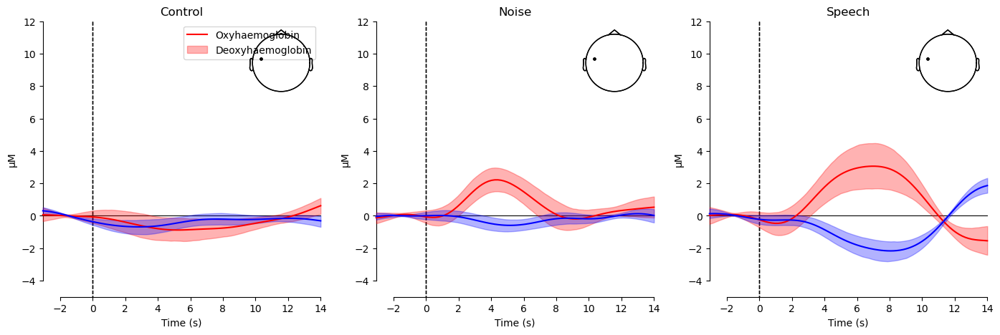

Optode: S4D3; Number of sessions: 41


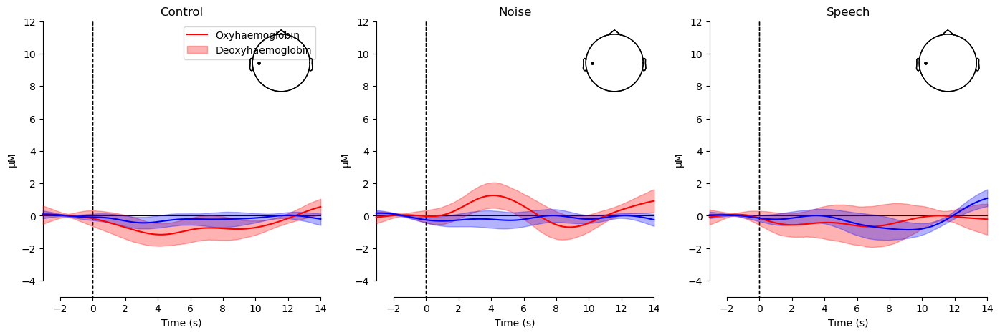

Optode: S5D2; Number of sessions: 41


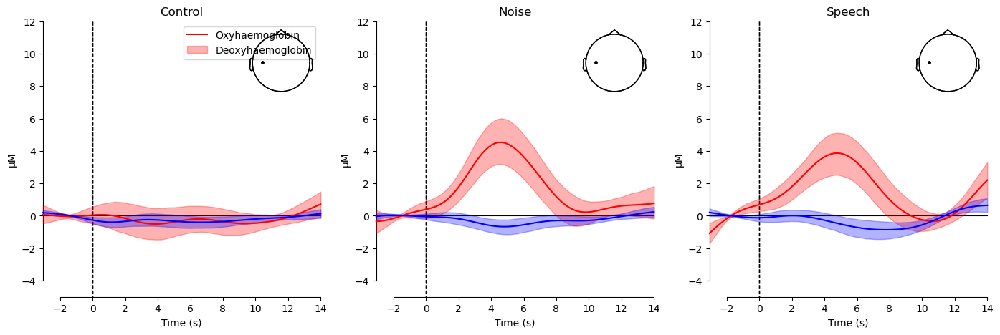

Optode: S5D3; Number of sessions: 32


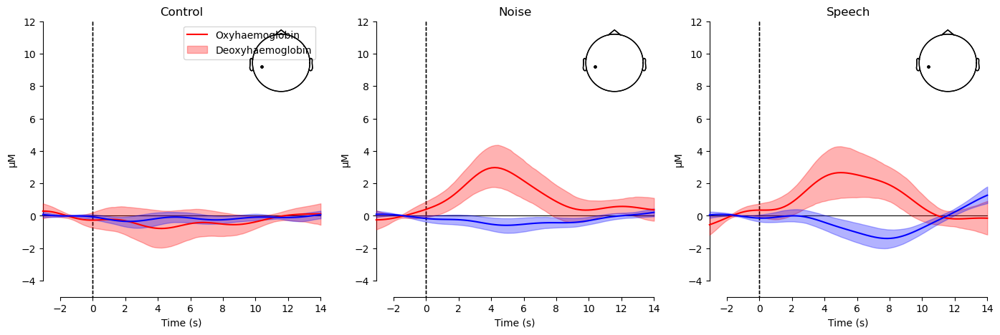

Optode: S5D4; Number of sessions: 41


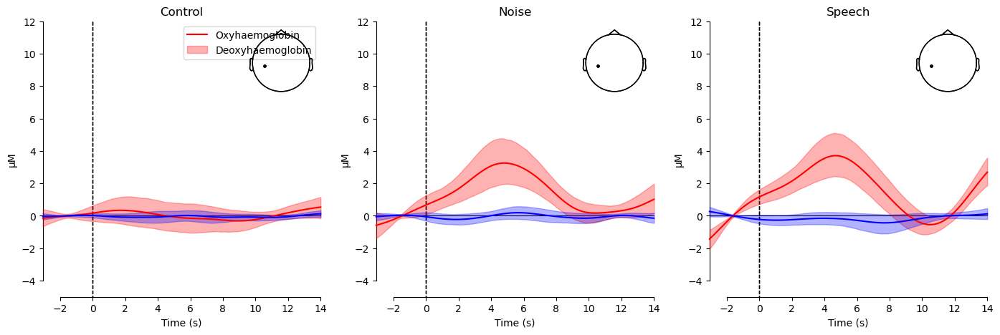

Optode: S5D5; Number of sessions: 38


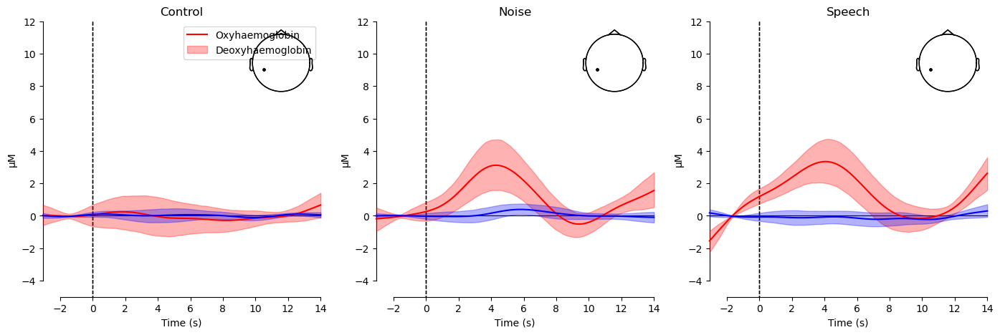

In [110]:
# Specify the figure size and limits per chromophore

Left_hemisphere_optodes = ["S4D2", "S4D3", "S5D2", "S5D3", "S5D4", "S5D5"]
Right_hemisphere_optodes = ["S10D9", "S10D10", "S10D11", "S10D12", "S11D11", "S11D12"]
Back_optodes = ["S6D6", "S6D8", "S7D6", "S7D7", "S7D8", "S8D7", "S8D8", "S9D8"]
Front_optodes = ["S1D1", "S2D1", "S3D1", "S3D2", "S12D1"]

for optode in Left_hemisphere_optodes:
    all_evokeds = all_evokeds_dict[optode]
    print(f"Optode: {optode}; Number of sessions: {len(all_evokeds['Control'])}")
    fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5))
    lims = dict(hbo=[-5, 12], hbr=[-5, 12])

    for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
        for idx, evoked in enumerate(all_evokeds):
            plot_compare_evokeds(
                {evoked: all_evokeds[evoked]},
                combine= None,
                picks=pick,
                axes=axes[idx],
                show=False,
                colors=[color],
                legend=False,
                ylim=lims,
                #ci=0.95,
                show_sensors=True
                
            )
            axes[idx].set_title(f"{evoked}")
    axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
    # show the figure
    plt.show()
    
    
    

Optode: S4D2; Number of sessions: 41


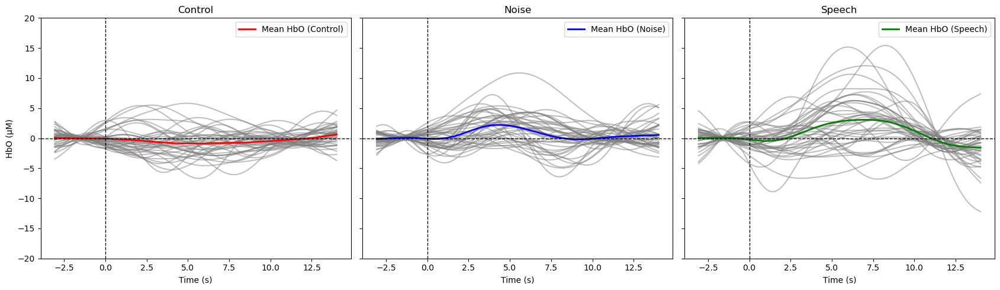

Optode: S6D6; Number of sessions: 28


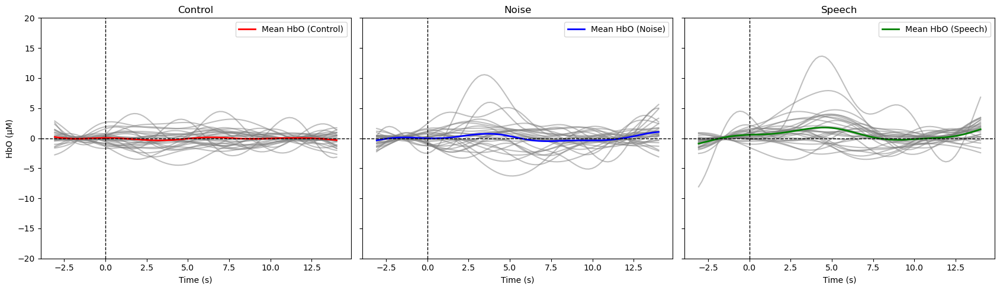

Optode: S4D3; Number of sessions: 41


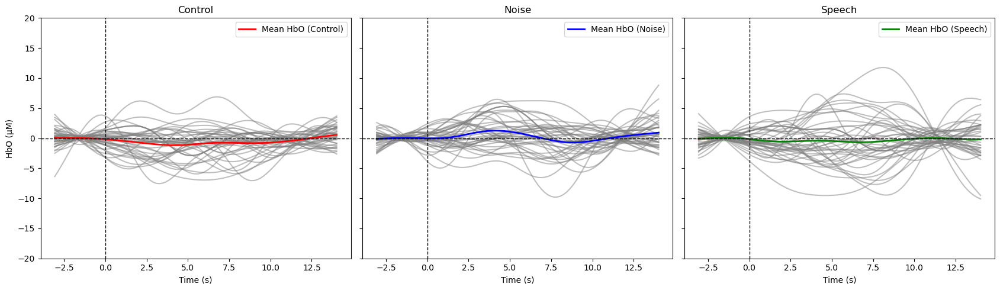

Optode: S5D2; Number of sessions: 41


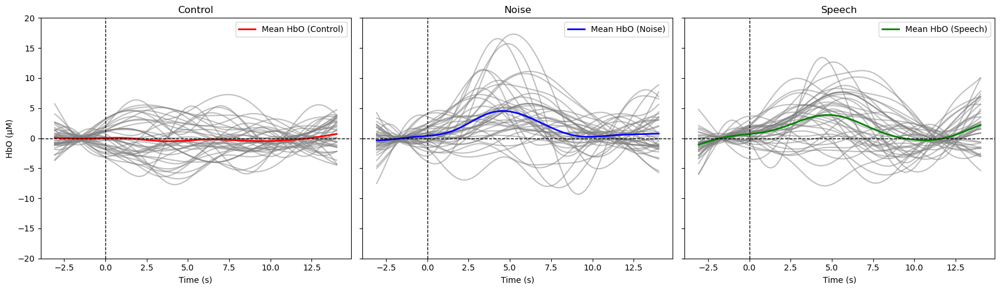

Optode: S5D3; Number of sessions: 32


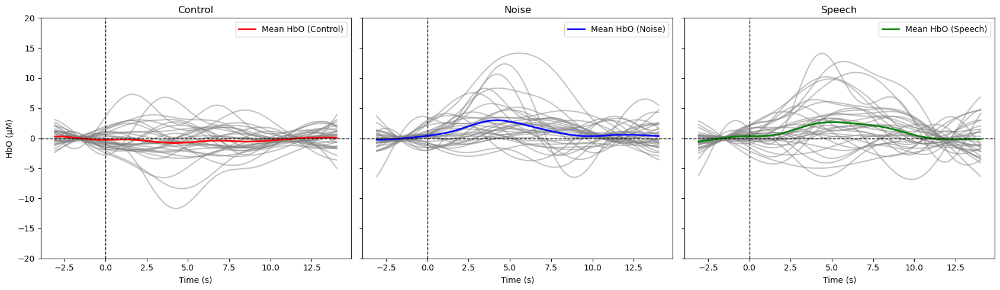

Optode: S5D4; Number of sessions: 41


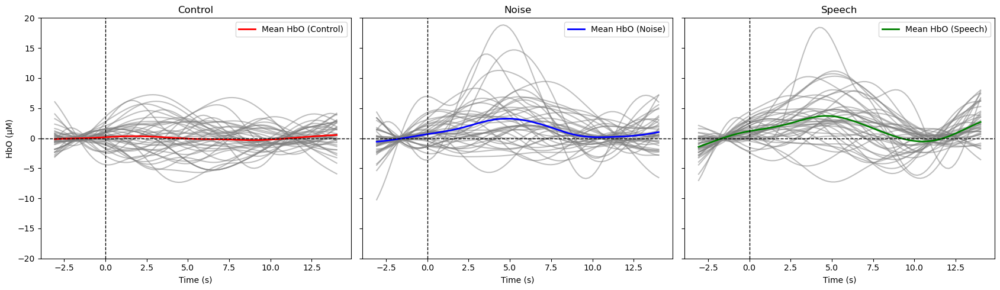

Optode: S5D5; Number of sessions: 38


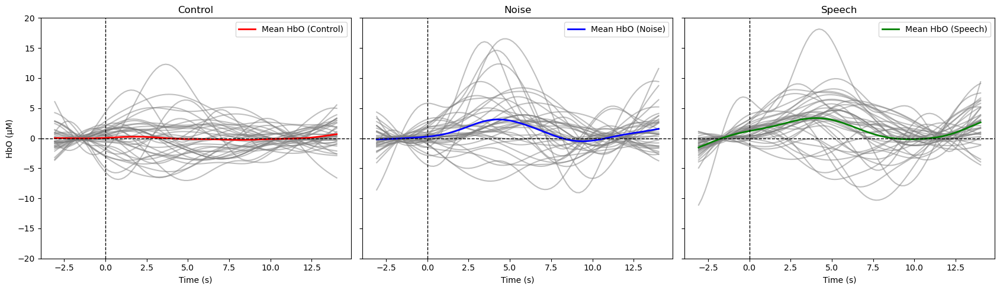

Optode: S10D9; Number of sessions: 37


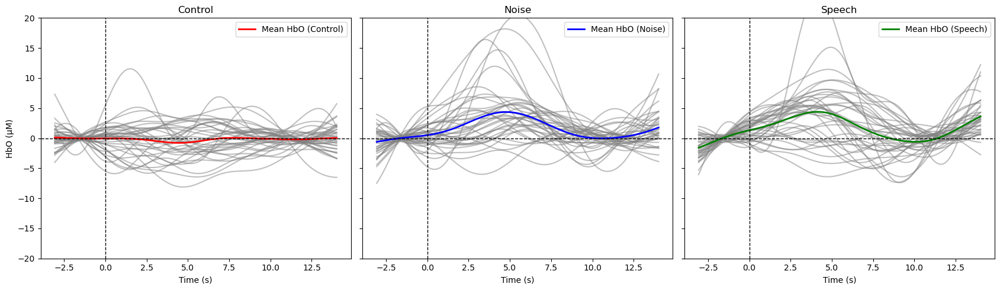

Optode: S10D10; Number of sessions: 39


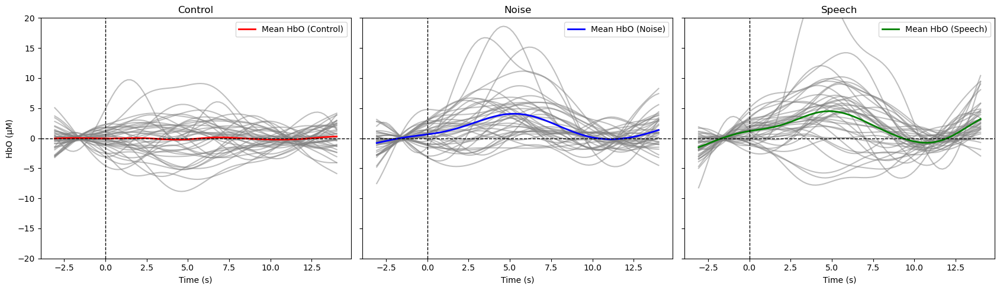

Optode: S10D11; Number of sessions: 40


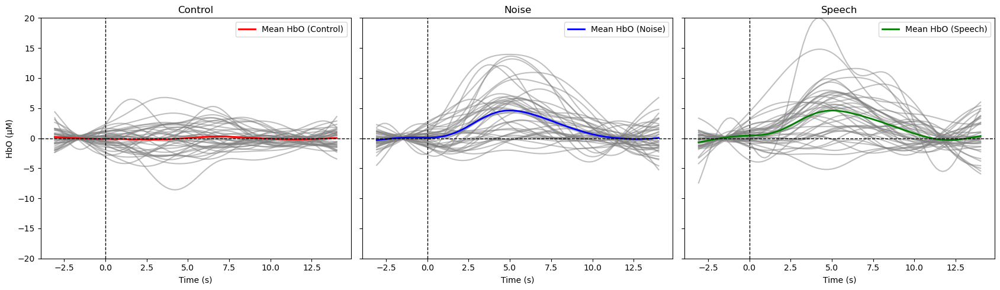

Optode: S10D12; Number of sessions: 41


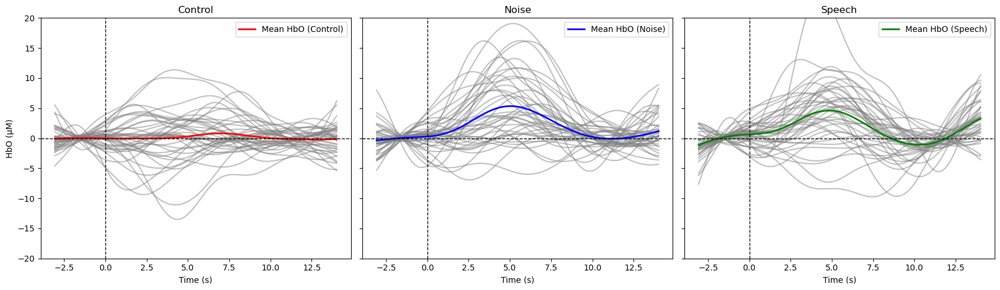

Optode: S11D11; Number of sessions: 45


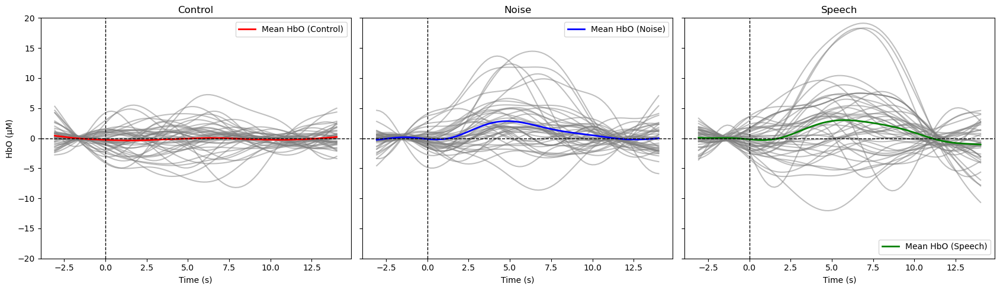

Optode: S11D12; Number of sessions: 45


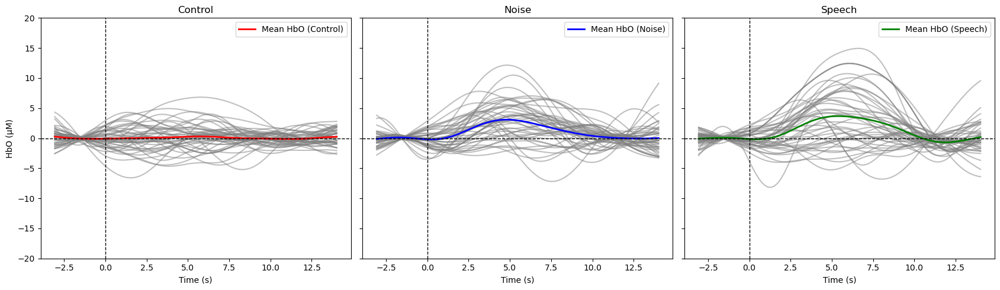

Optode: S6D8; Number of sessions: 35


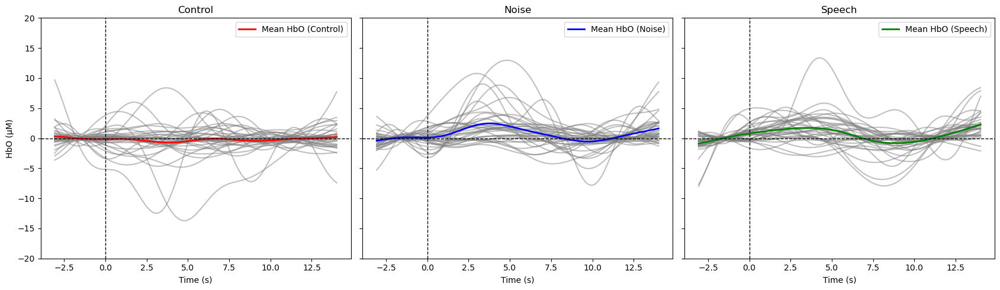

Optode: S7D6; Number of sessions: 21


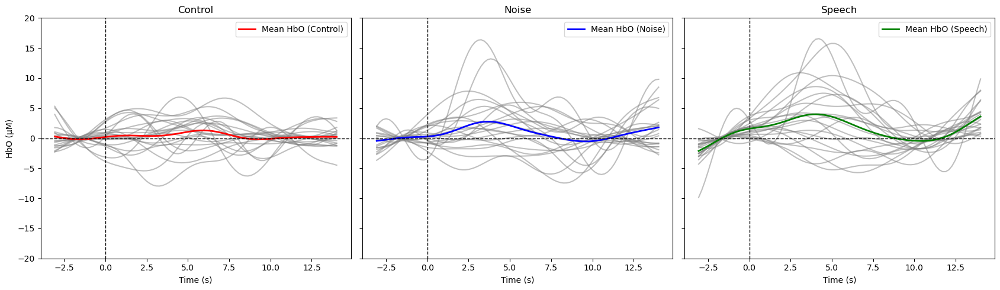

Optode: S7D7; Number of sessions: 33


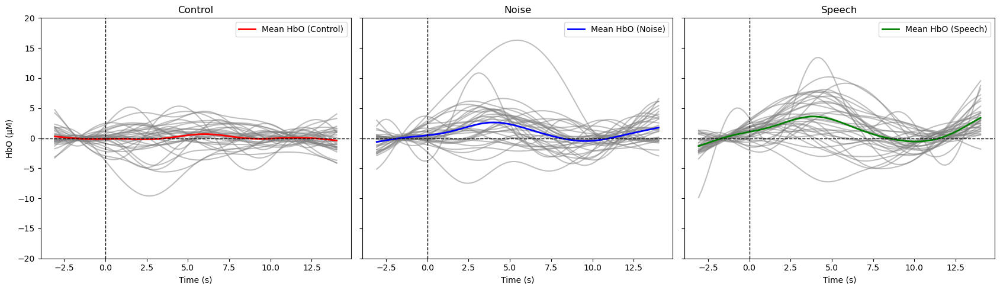

Optode: S7D8; Number of sessions: 18


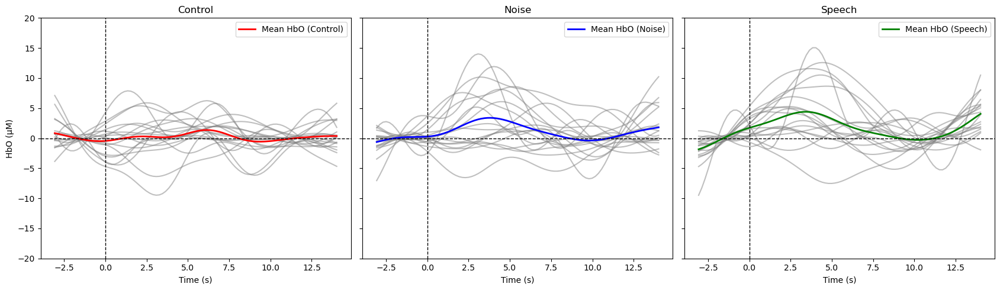

Optode: S8D7; Number of sessions: 33


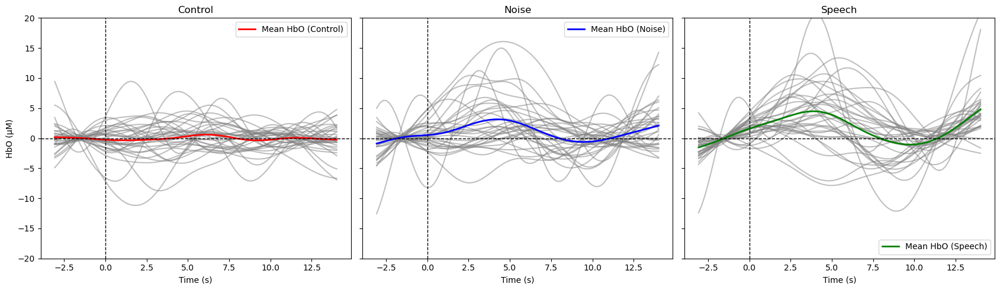

Optode: S8D8; Number of sessions: 35


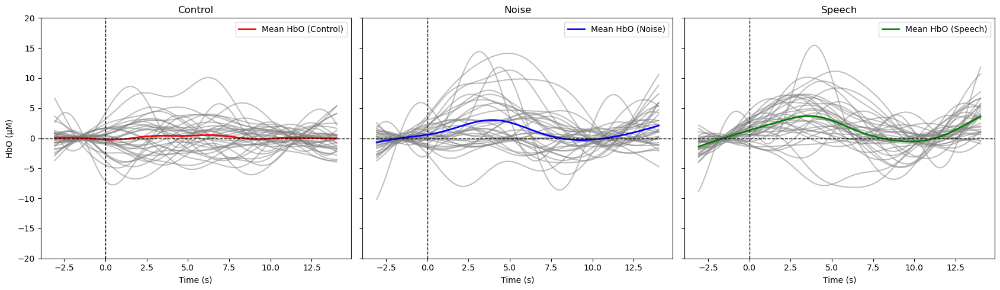

Optode: S9D8; Number of sessions: 26


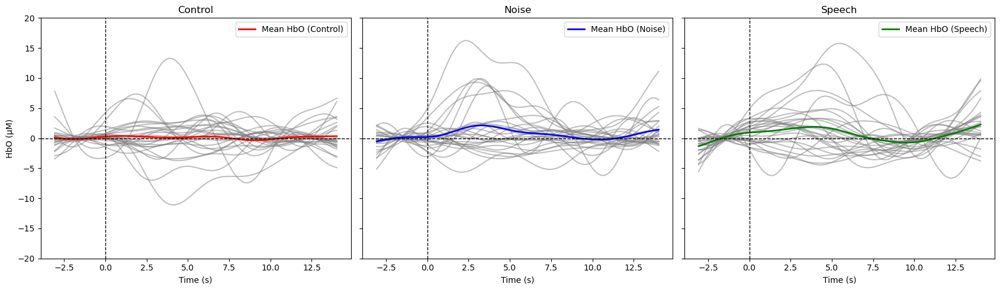

Optode: S1D1; Number of sessions: 45


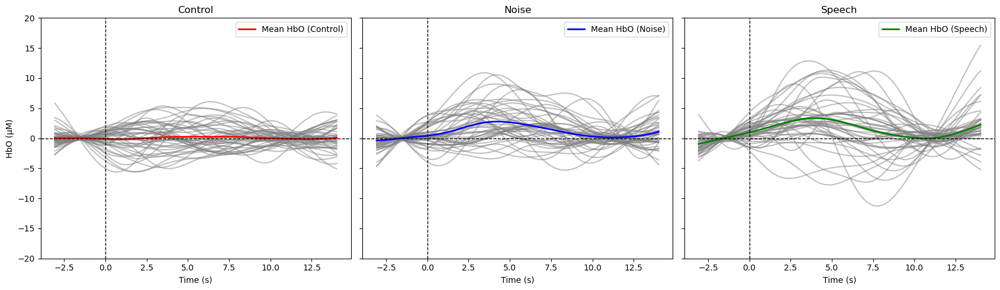

Optode: S2D1; Number of sessions: 45


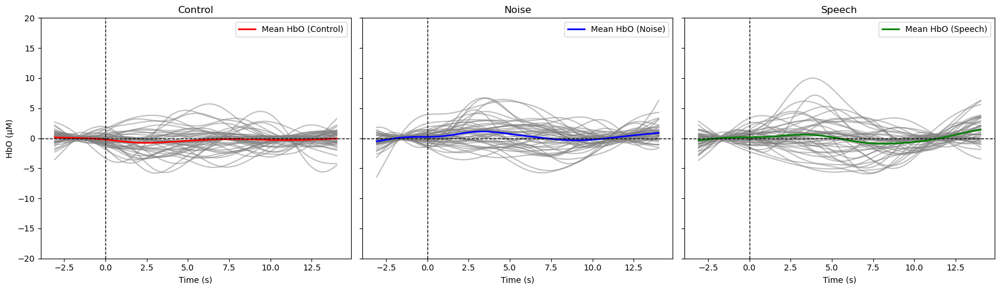

Optode: S3D1; Number of sessions: 45


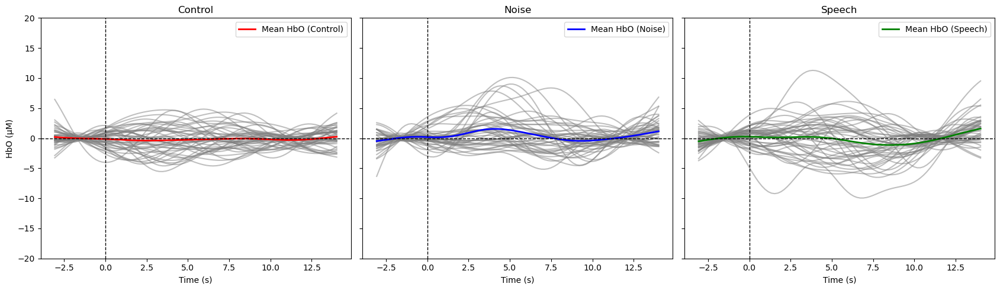

Optode: S3D2; Number of sessions: 44


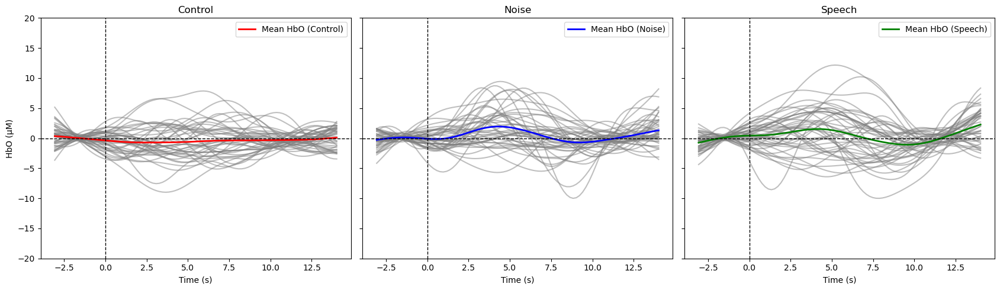

Optode: S12D1; Number of sessions: 45


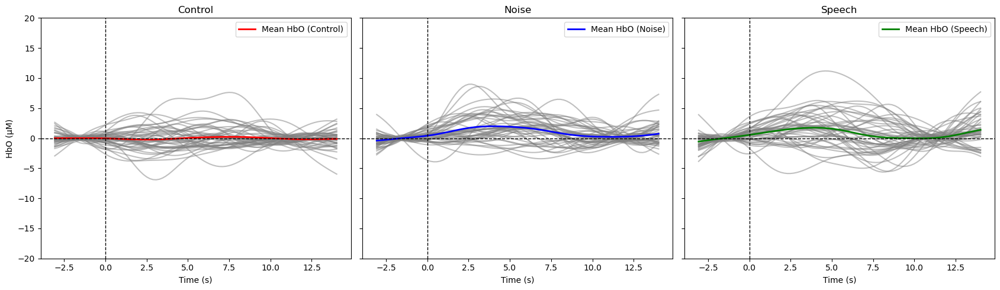

In [111]:

# correction
# Define colors for each condition
condition_colors = ["red", "blue", "green"]  # Adjust as needed

for optode in optodes:
    all_evokeds = all_evokeds_dict[optode]
    print(f"Optode: {optode}; Number of sessions: {len(all_evokeds['Control'])}")
    
    if len(all_evokeds['Control']) == 0:
        print(f"No evoked responses for optode {optode}. Skipping...")
        continue
    else:
        # Create subplots with shared axes
        fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5), sharey=True, sharex=True)

        # Find global min/max for y-axis limits

        y_min, y_max = -20, 20

        # Iterate over each condition and plot
        for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
            ax = axes[idx]  # Select subplot
            color = condition_colors[idx]  # Assign color

            # Extract time points
            times = evoked_list[0].times

            # Extract only HbO data
            hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # (n_participants, n_channels, n_times)

            # Compute a dictionary of means across participants should be size n_participants x n_times
            mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
            for i in range(len(hbo_data)):
                mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
                
            # Now we calculate the mean across participants   
            mean_hbo = np.mean(mean_channels_all_part, axis=0)  # (1,n_times)

            # Plot individual participants in light gray
            for i in range(len(hbo_data)):
                ax.plot(times, mean_channels_all_part[i,:]* 1e6, color="gray", alpha=0.5)

            # Plot the mean with a distinct color
            ax.plot(times, mean_hbo* 1e6, color=color, linewidth=2, label=f"Mean HbO ({condition})")

            # Mark x=0 and y=0 axes in black
            ax.axhline(0, color='black', linewidth=1, linestyle='--')  # y=0 axis
            ax.axvline(0, color='black', linewidth=1, linestyle='--')  # x=0 axis

            # Formatting
            ax.set_title(condition)
            ax.set_xlabel("Time (s)")
            if idx == 0:  # Only label y-axis on first subplot
                ax.set_ylabel("HbO (μM)")
            ax.legend()

        # Set the same y-axis limits for all subplots
        plt.ylim(y_min, y_max)
        plt.tight_layout()
        plt.show()

Optode: S4D2; Number of sessions: 41


C:\Users\sarab\AppData\Local\Temp\ipykernel_5536\3633281297.py:24: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("tab20", num_participants)


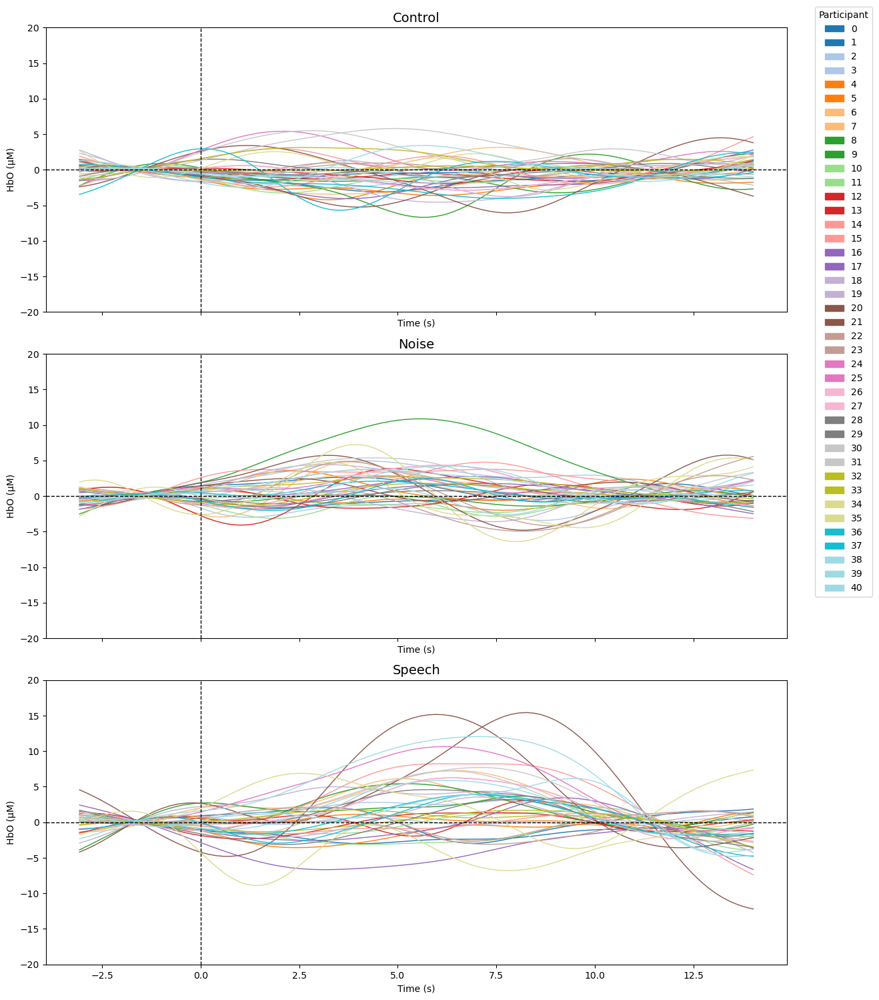

Optode: S6D6; Number of sessions: 28


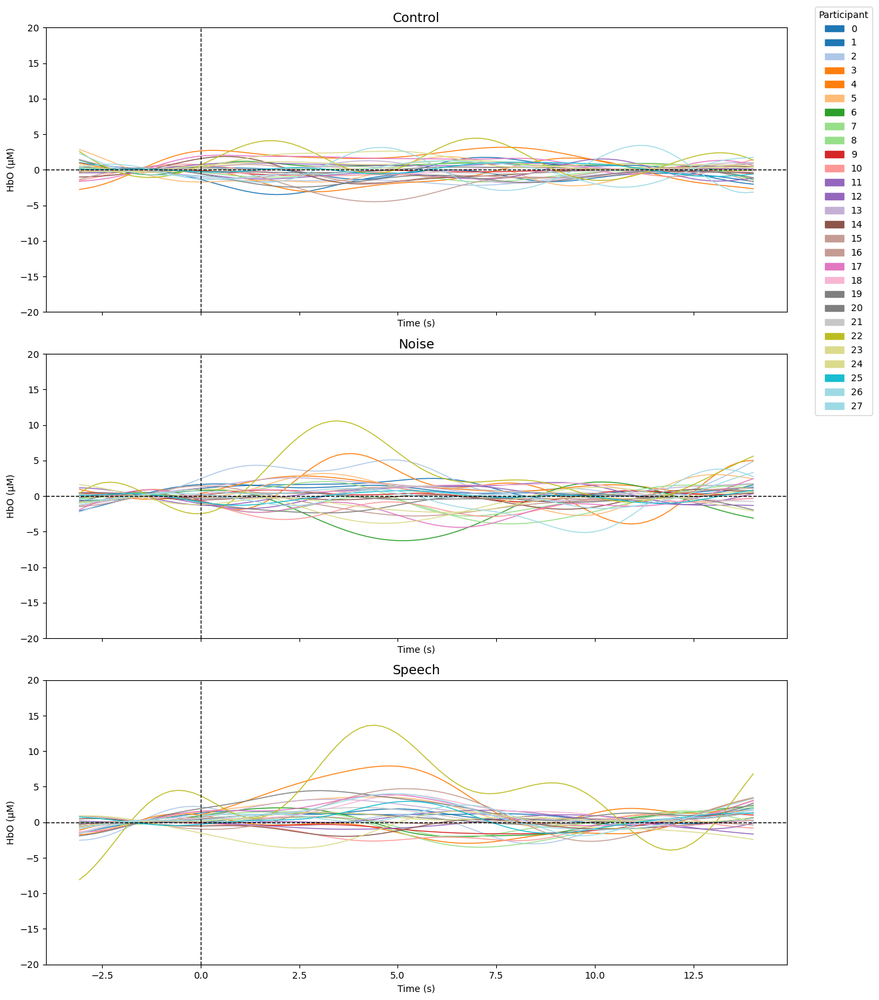

Optode: S4D3; Number of sessions: 41


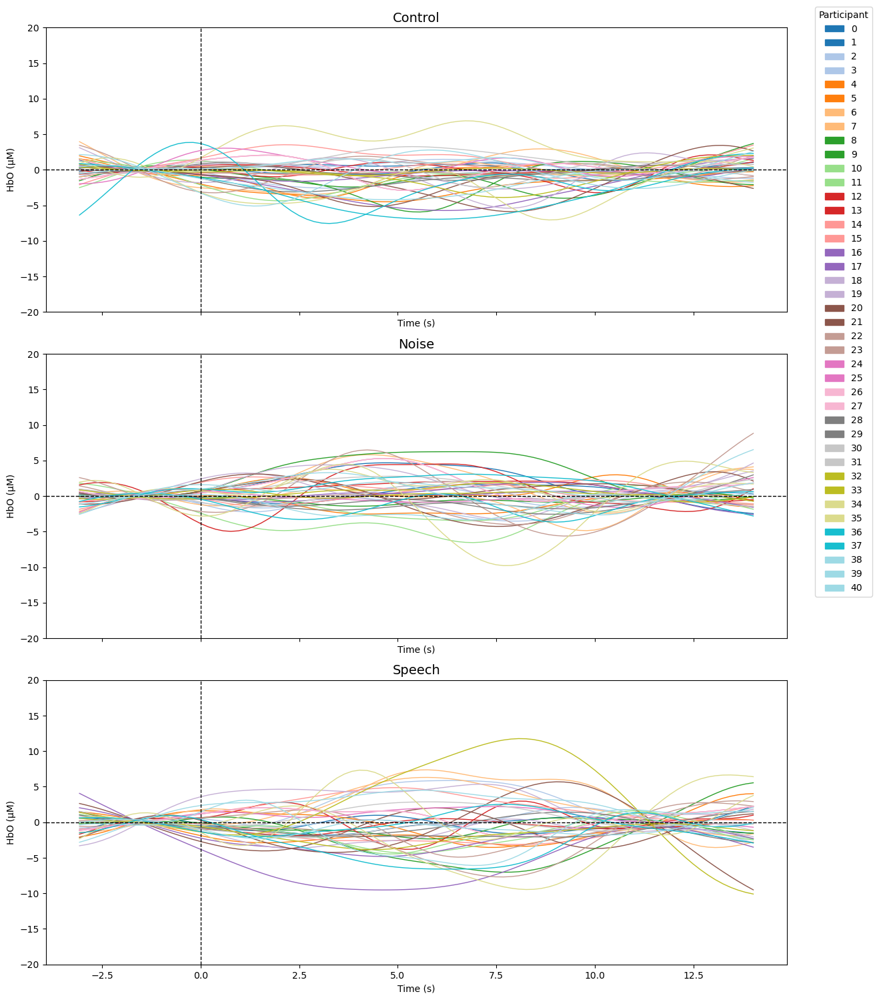

Optode: S5D2; Number of sessions: 41


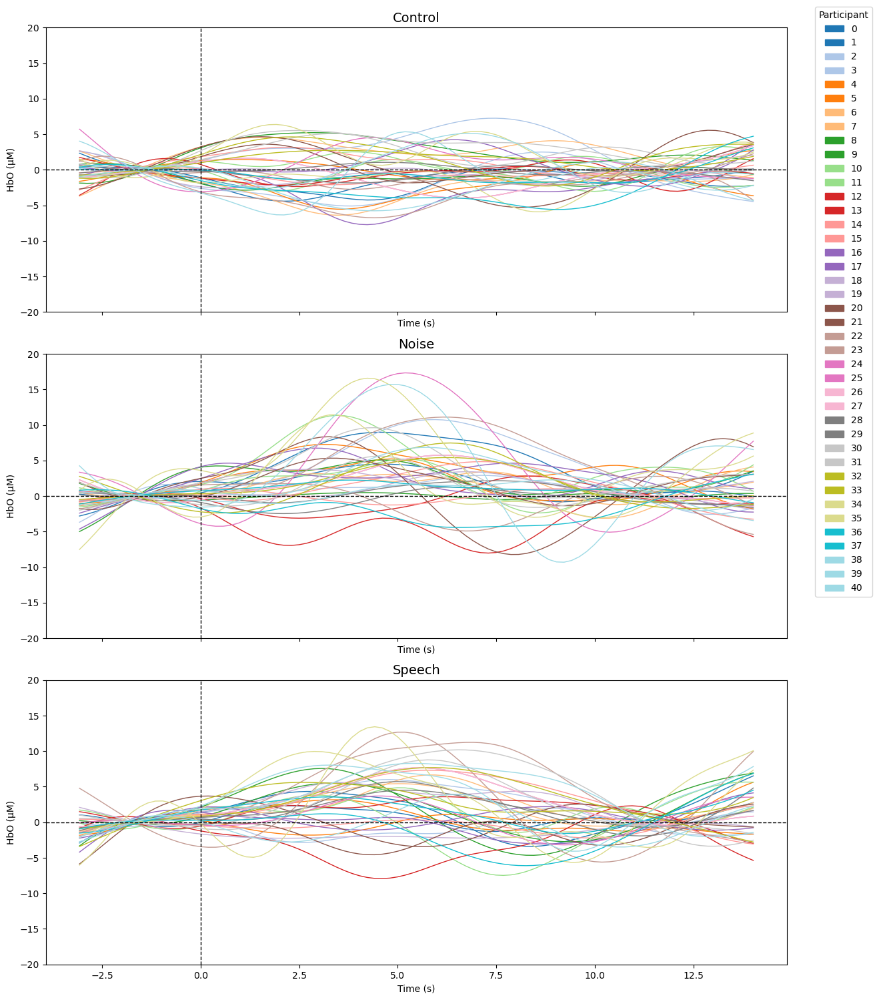

Optode: S5D3; Number of sessions: 32


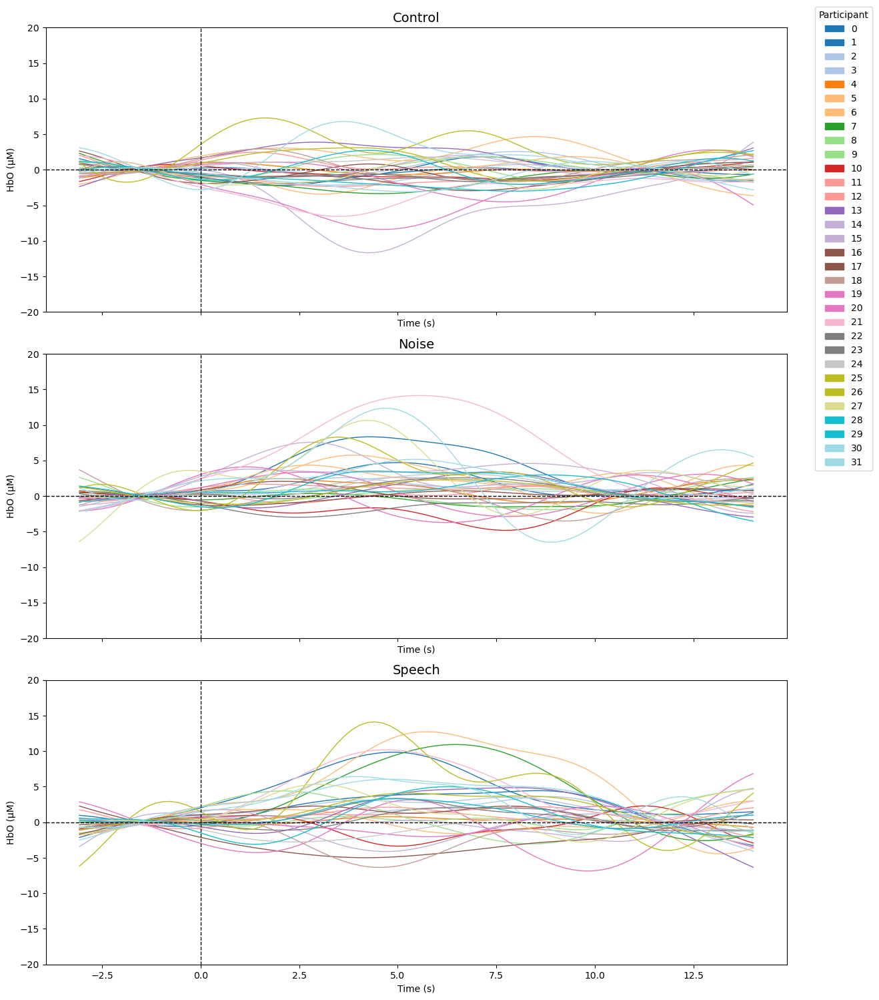

Optode: S5D4; Number of sessions: 41


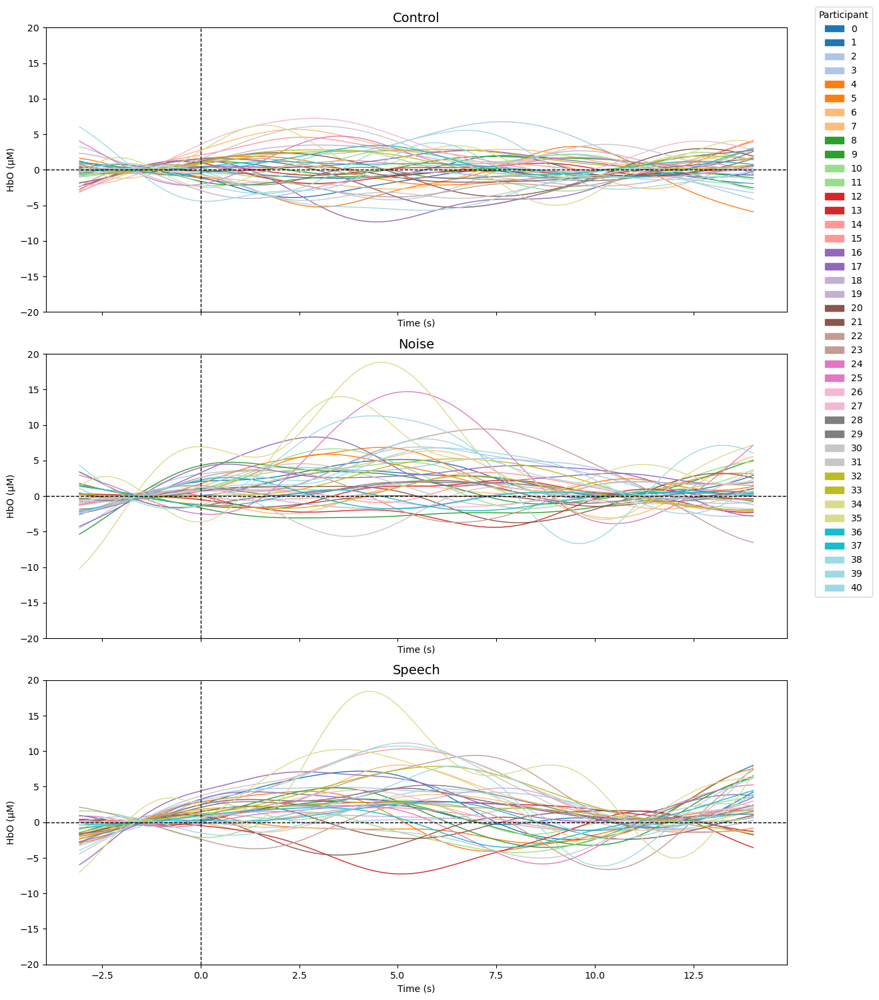

Optode: S5D5; Number of sessions: 38


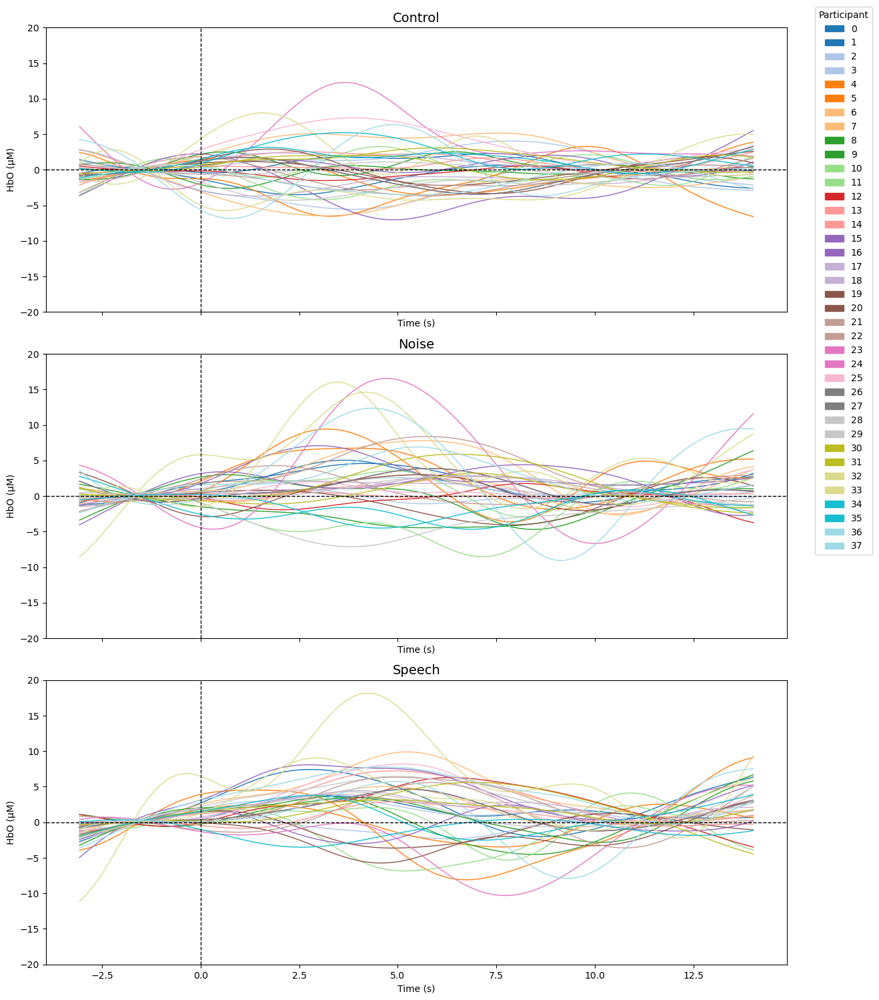

Optode: S10D9; Number of sessions: 37


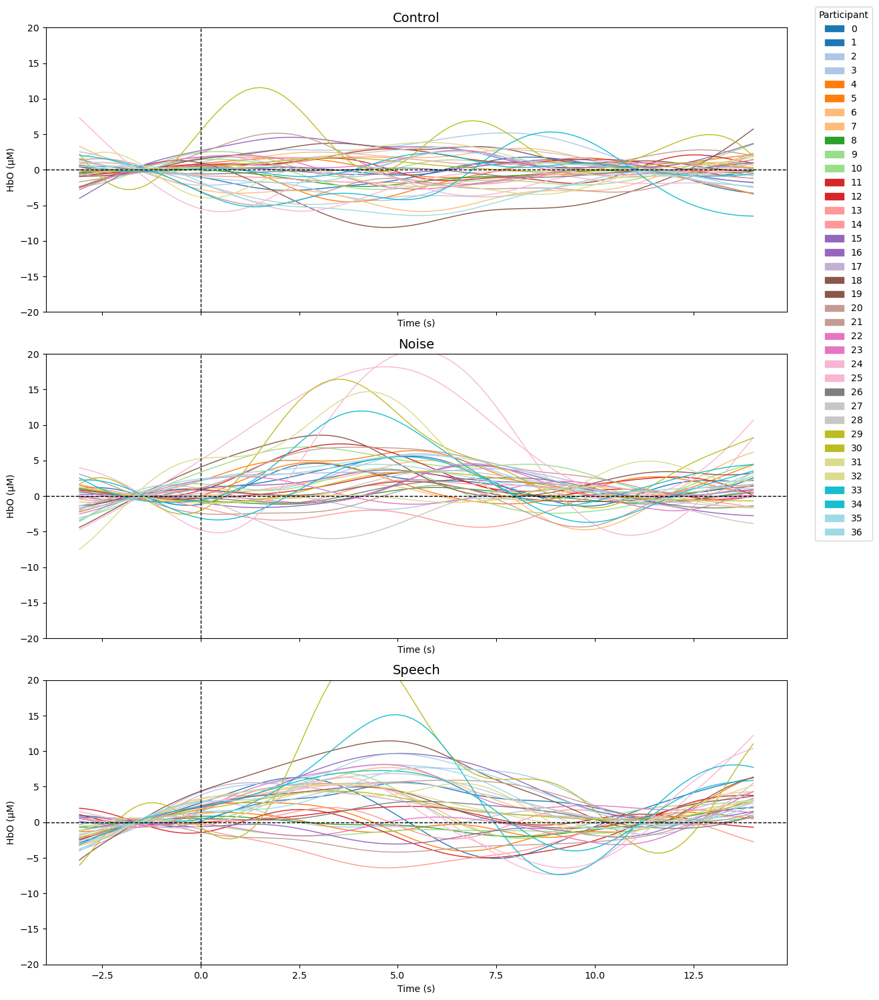

Optode: S10D10; Number of sessions: 39


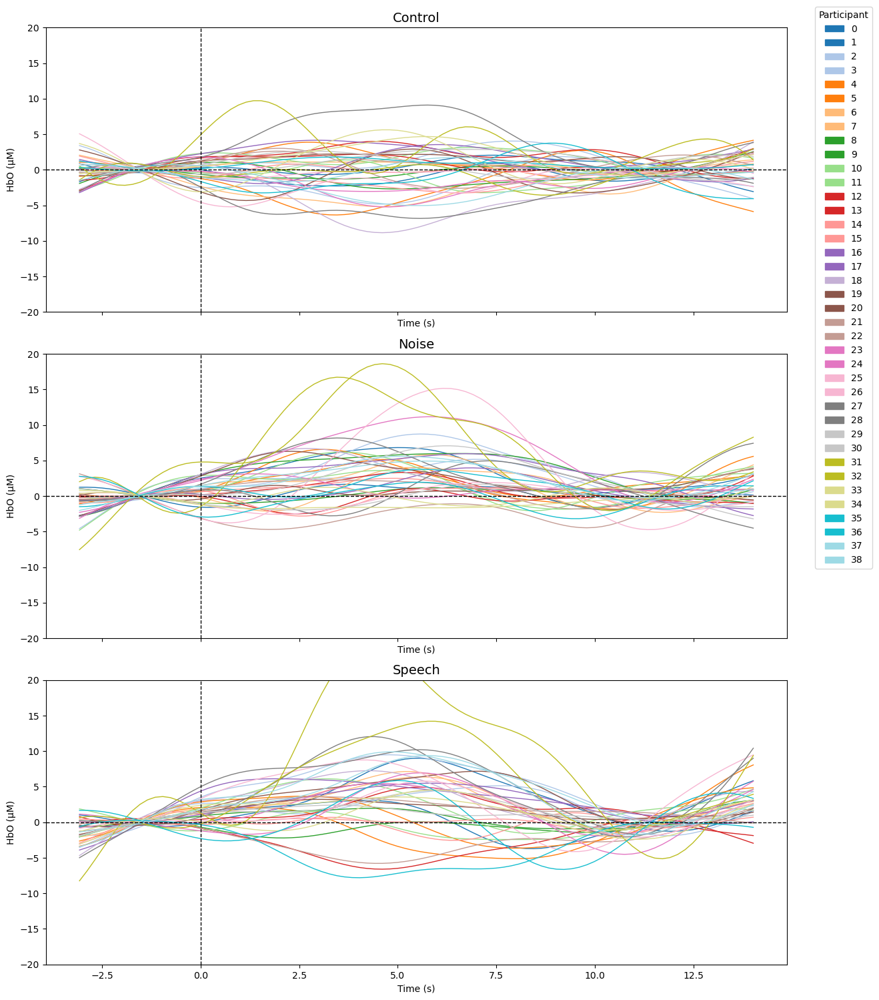

Optode: S10D11; Number of sessions: 40


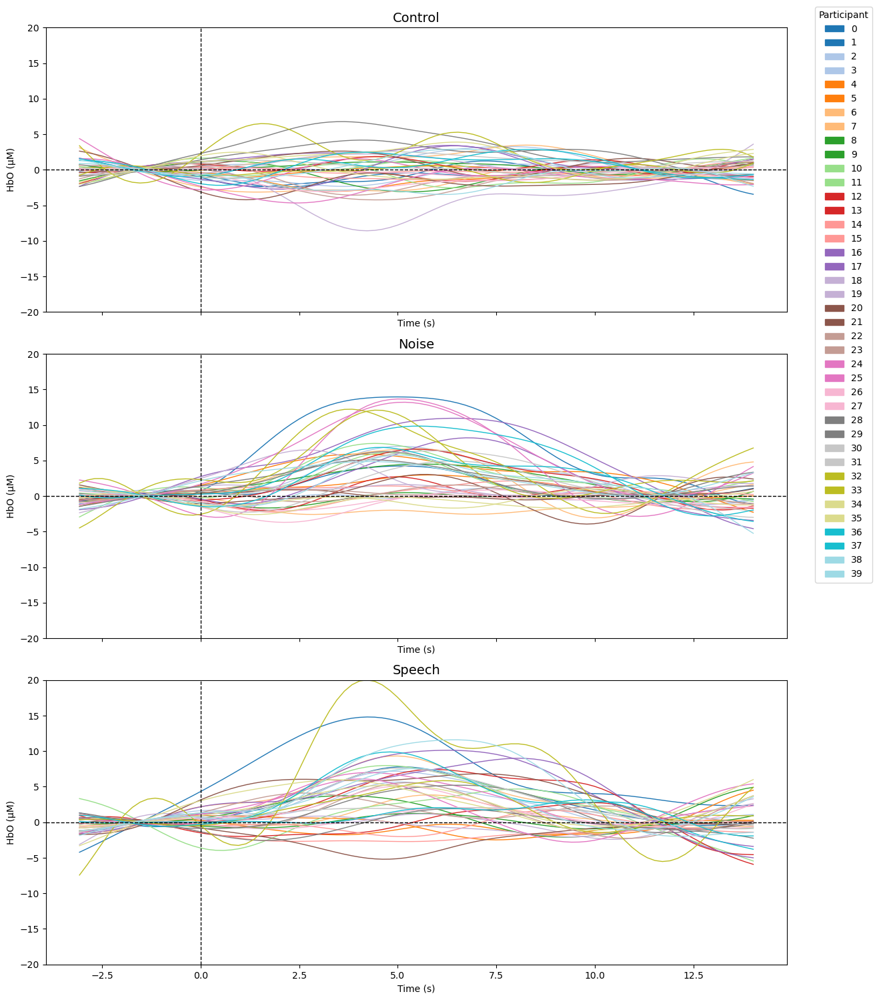

Optode: S10D12; Number of sessions: 41


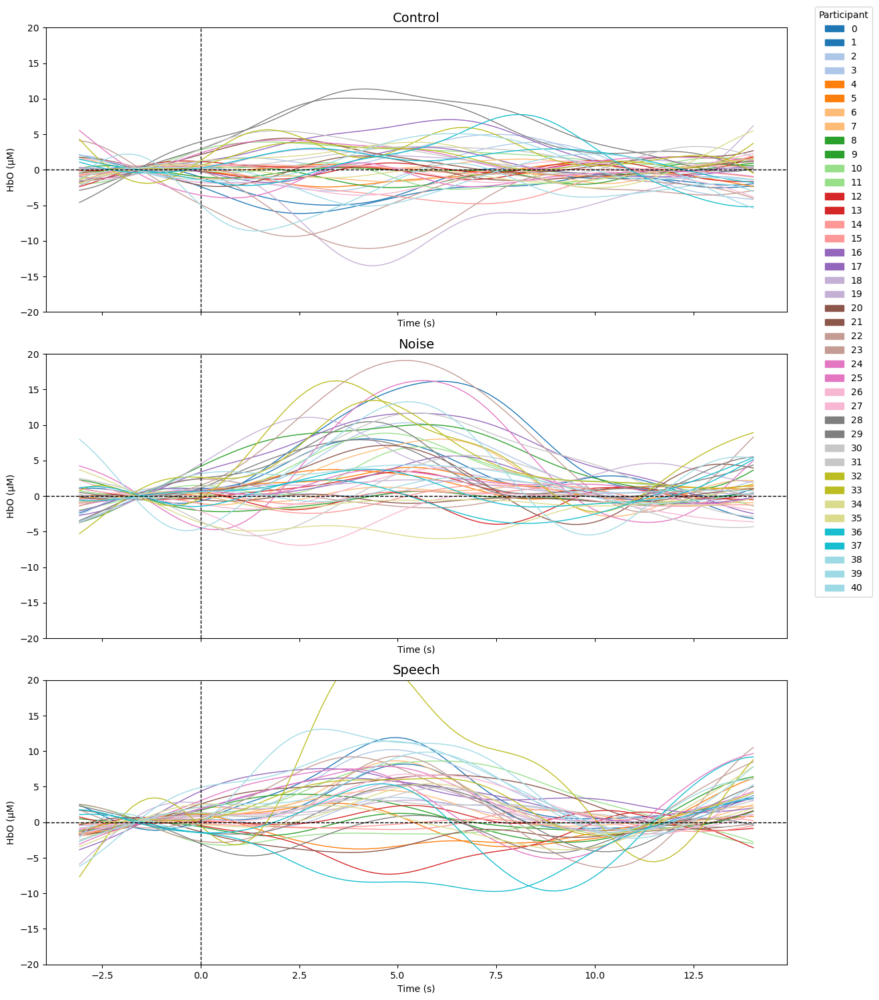

Optode: S11D11; Number of sessions: 45


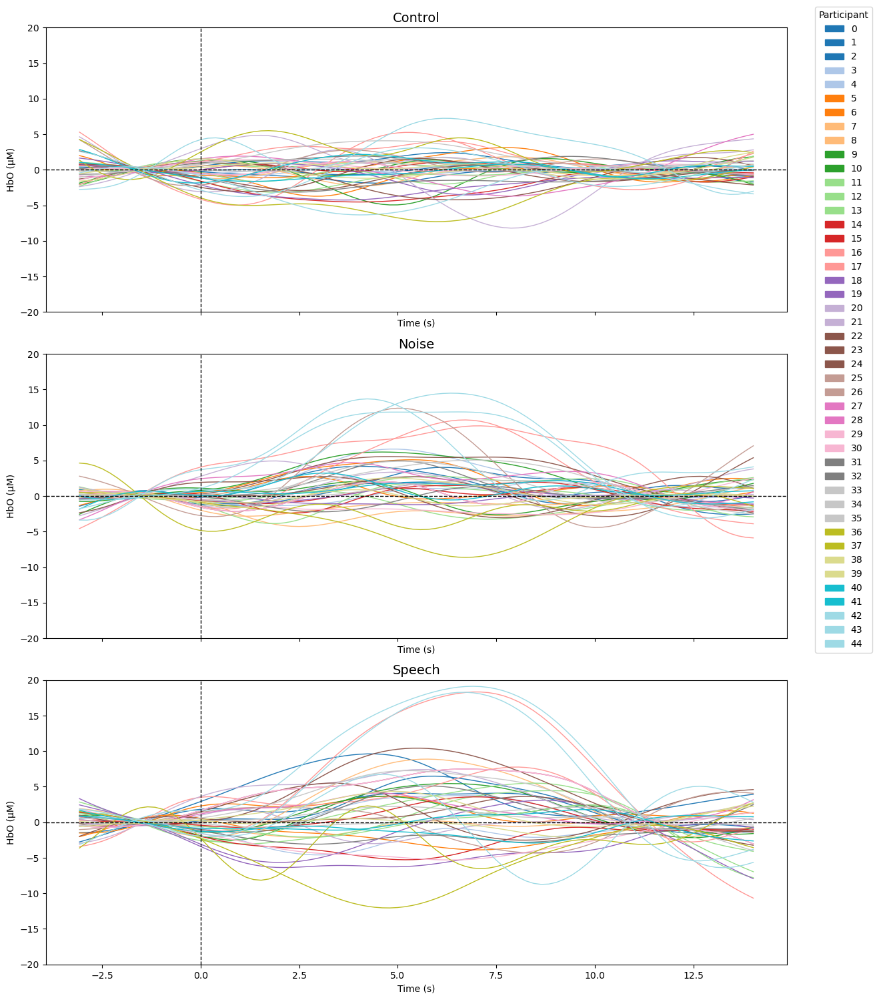

Optode: S11D12; Number of sessions: 45


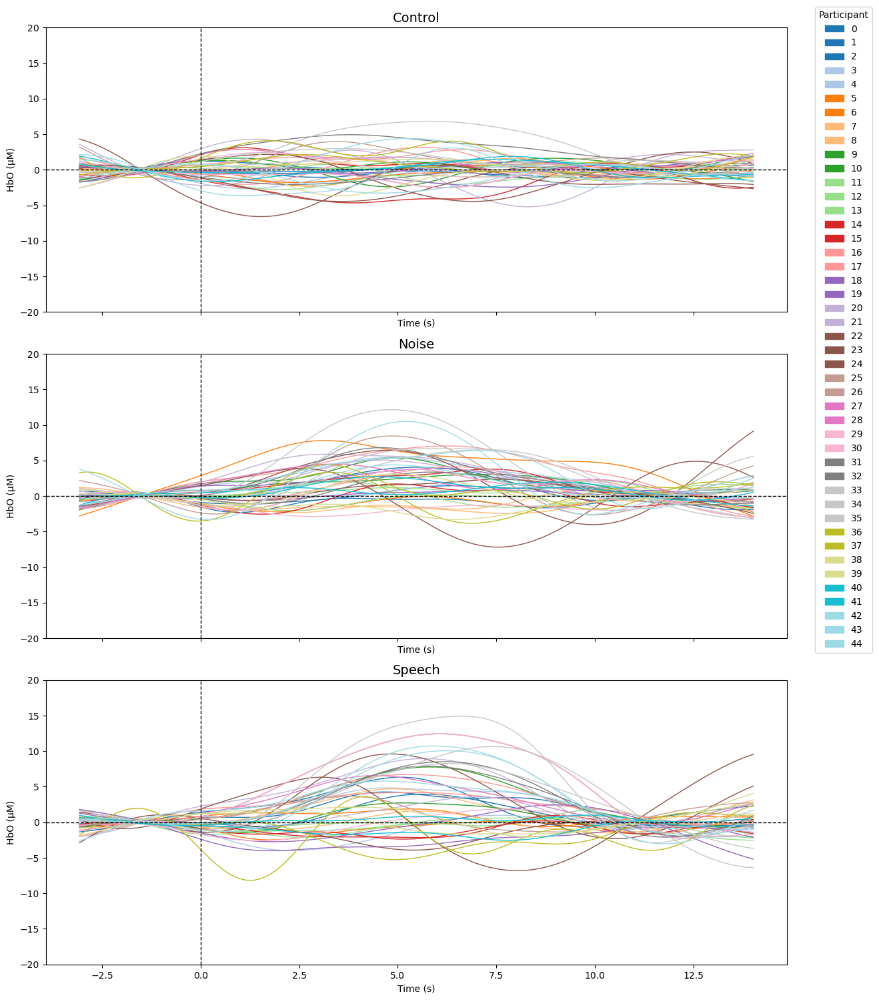

Optode: S6D8; Number of sessions: 35


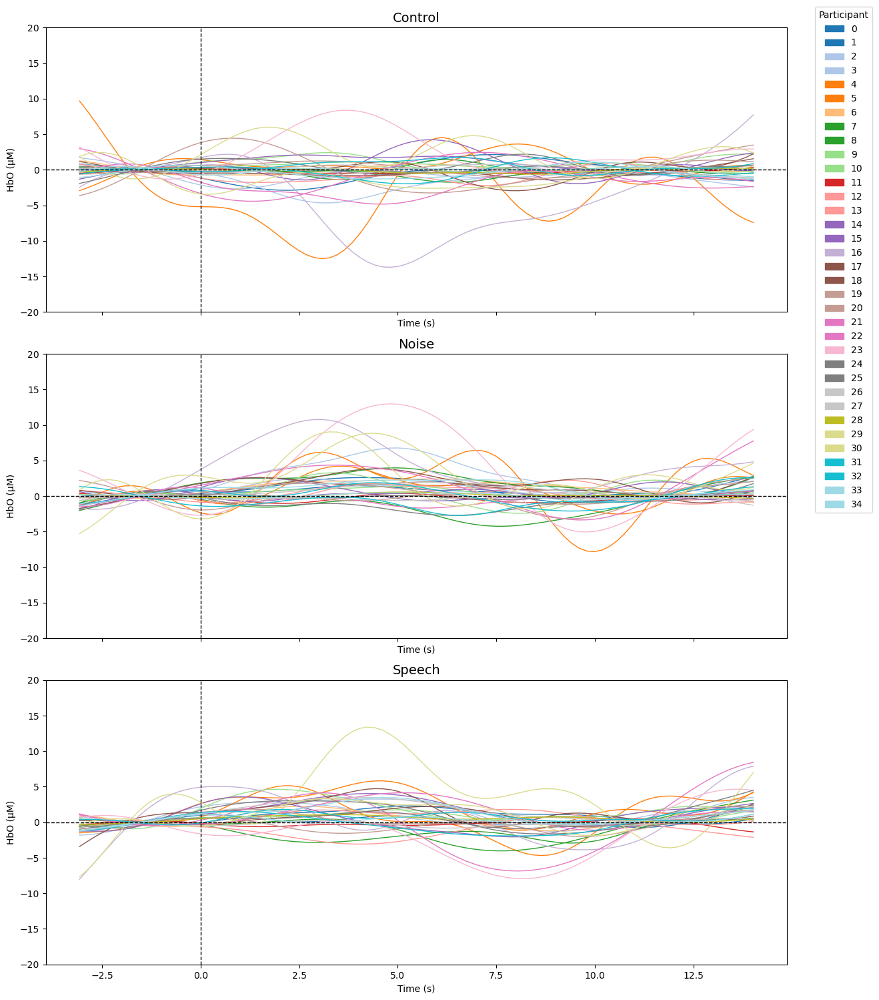

Optode: S7D6; Number of sessions: 21


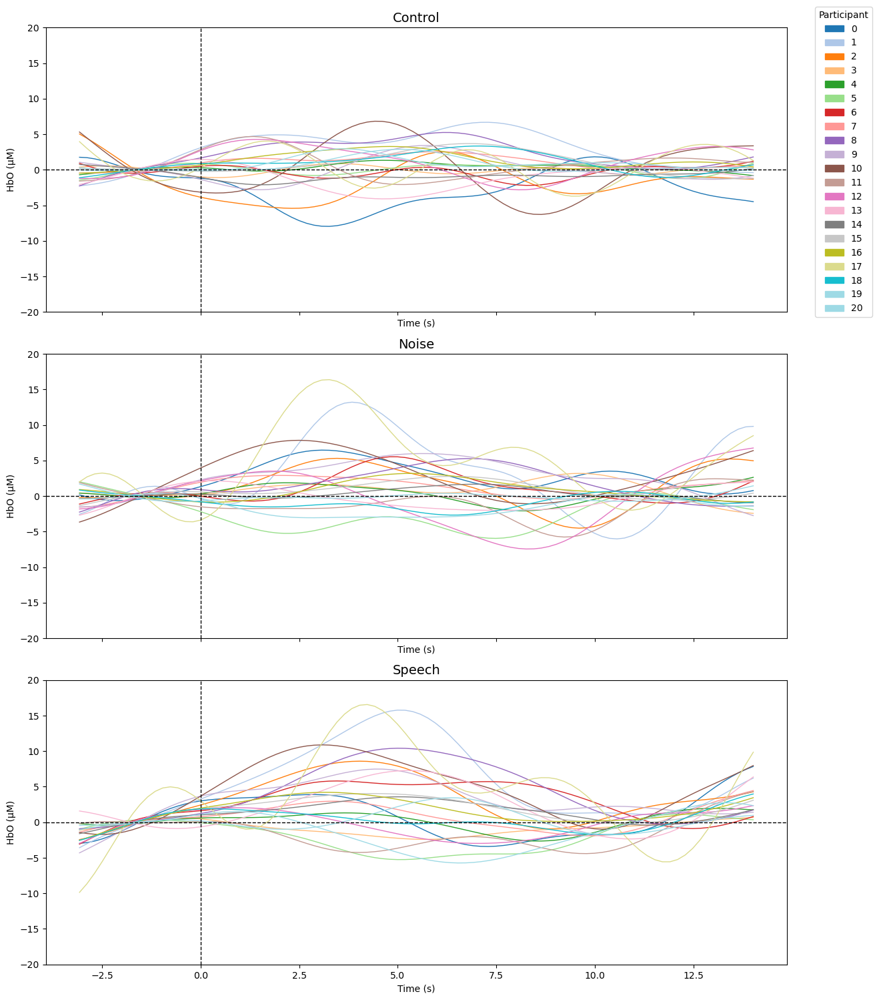

Optode: S7D7; Number of sessions: 33


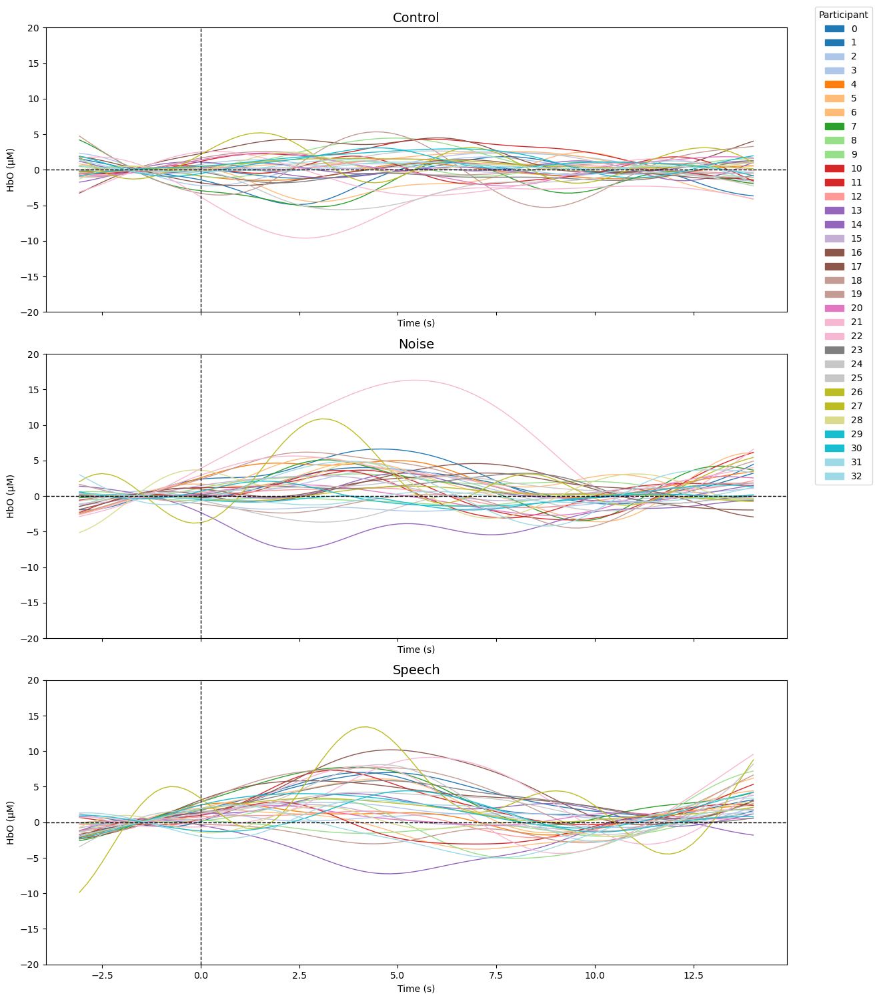

Optode: S7D8; Number of sessions: 18


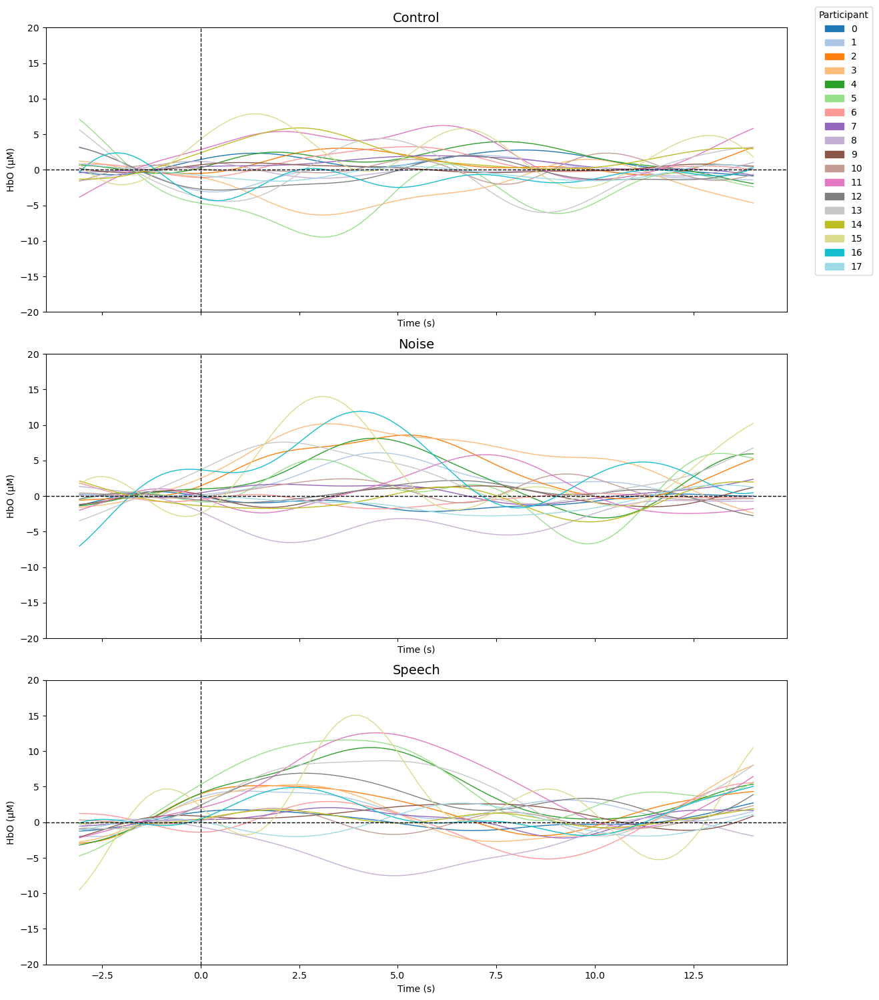

Optode: S8D7; Number of sessions: 33


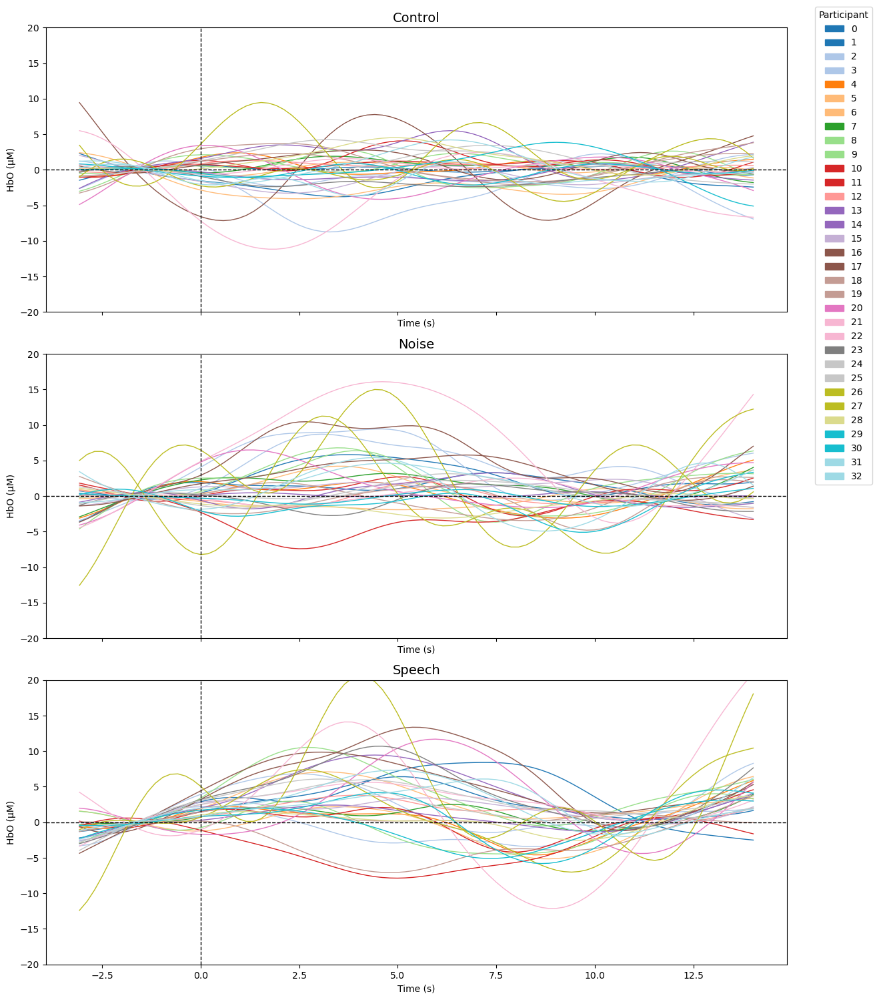

Optode: S8D8; Number of sessions: 35


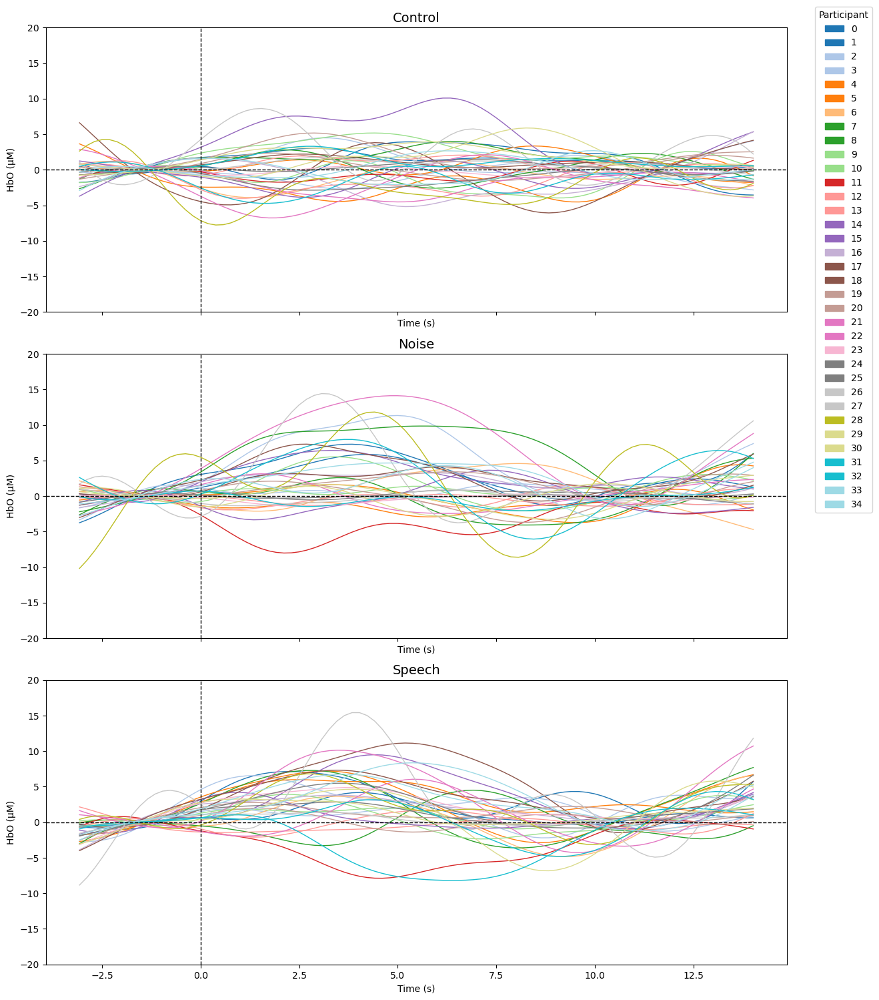

Optode: S9D8; Number of sessions: 26


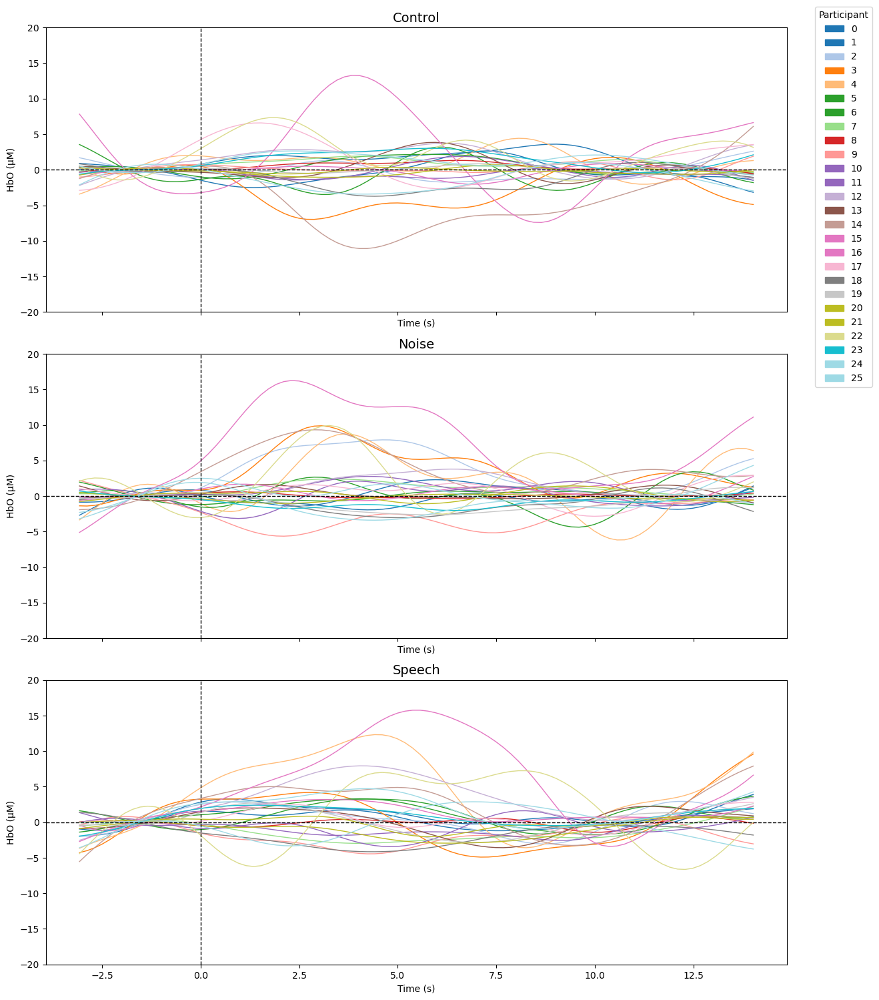

Optode: S1D1; Number of sessions: 45


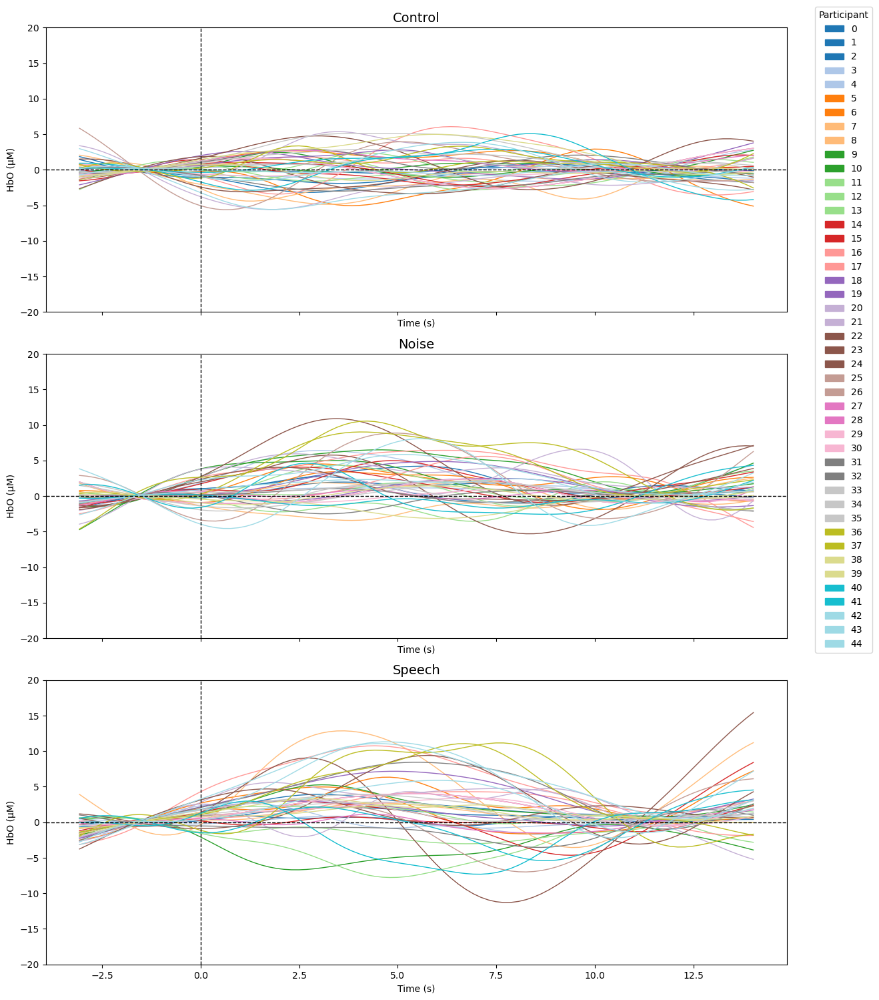

Optode: S2D1; Number of sessions: 45


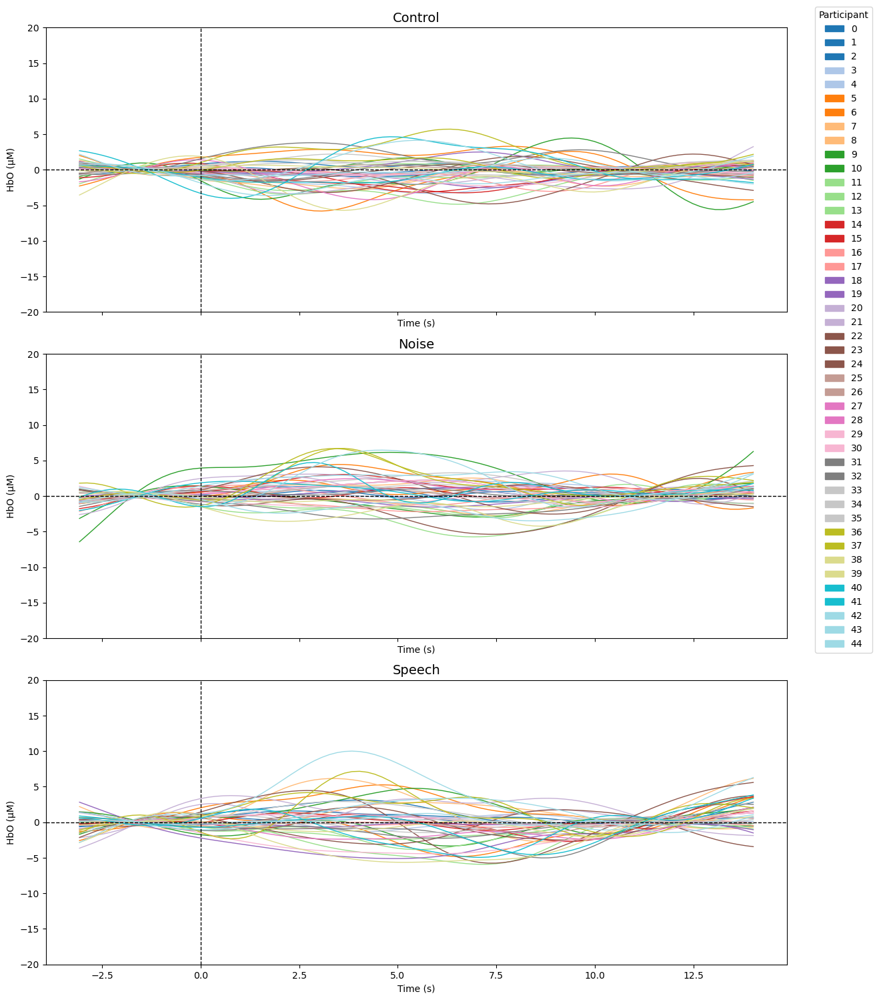

Optode: S3D1; Number of sessions: 45


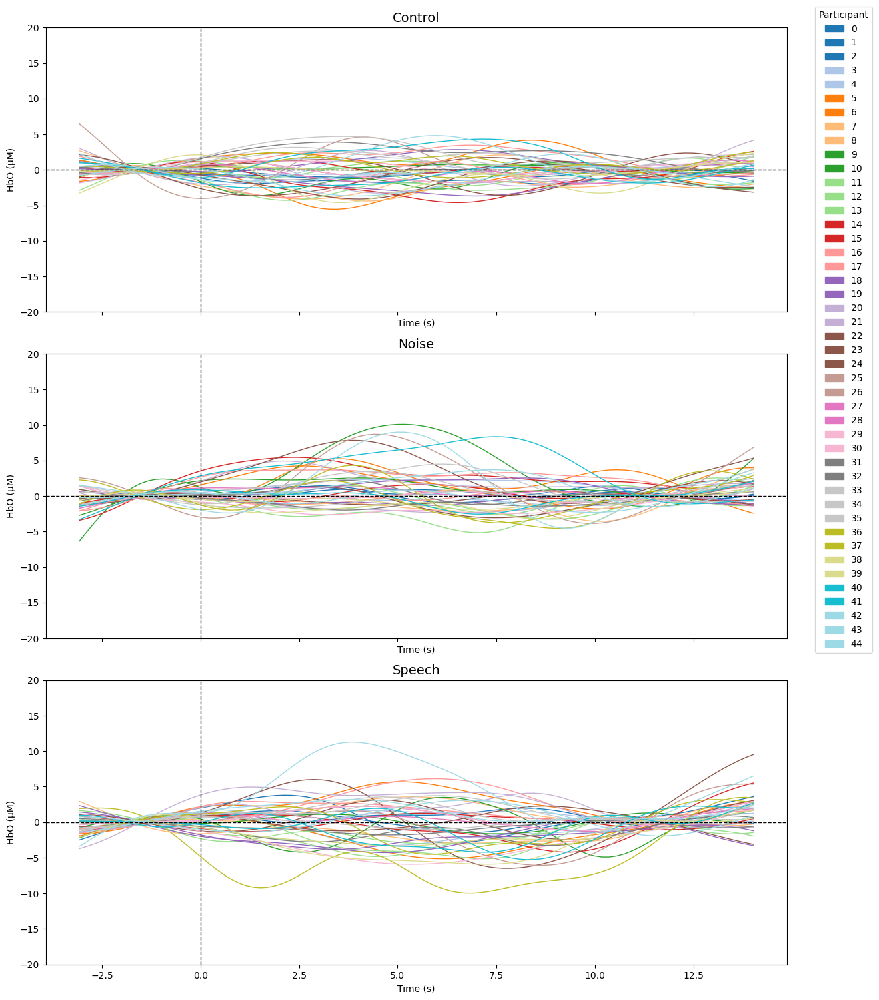

Optode: S3D2; Number of sessions: 44


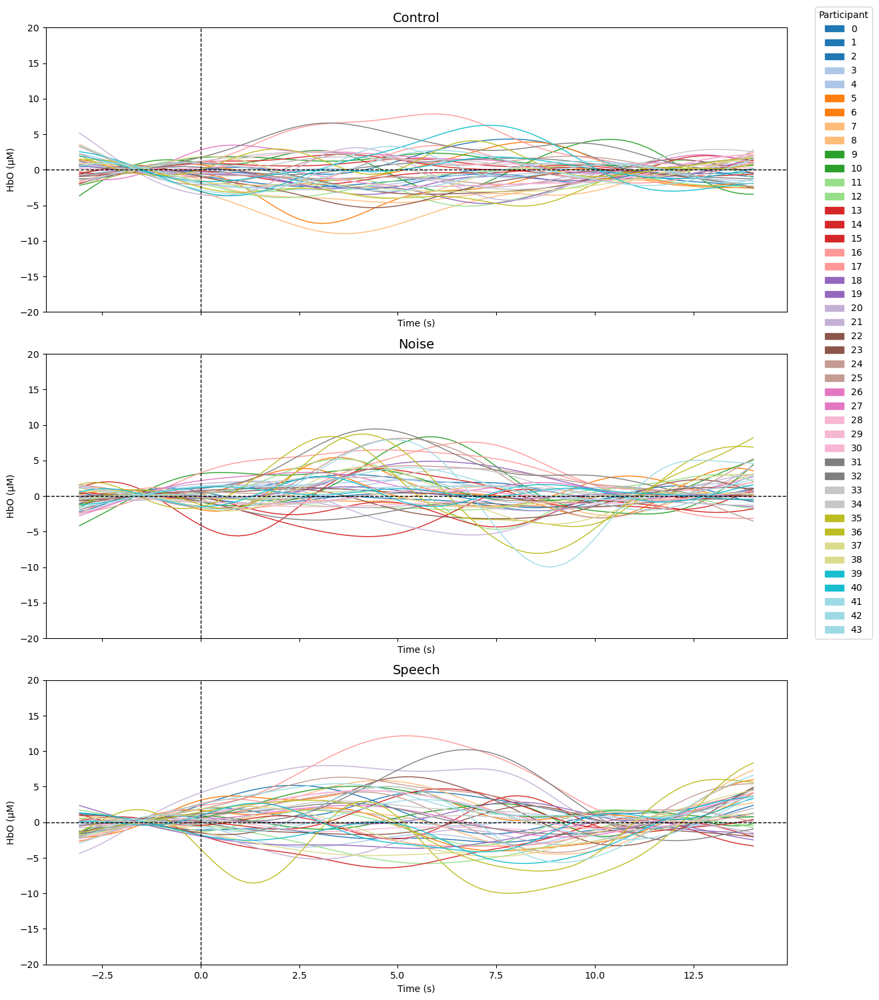

Optode: S12D1; Number of sessions: 45


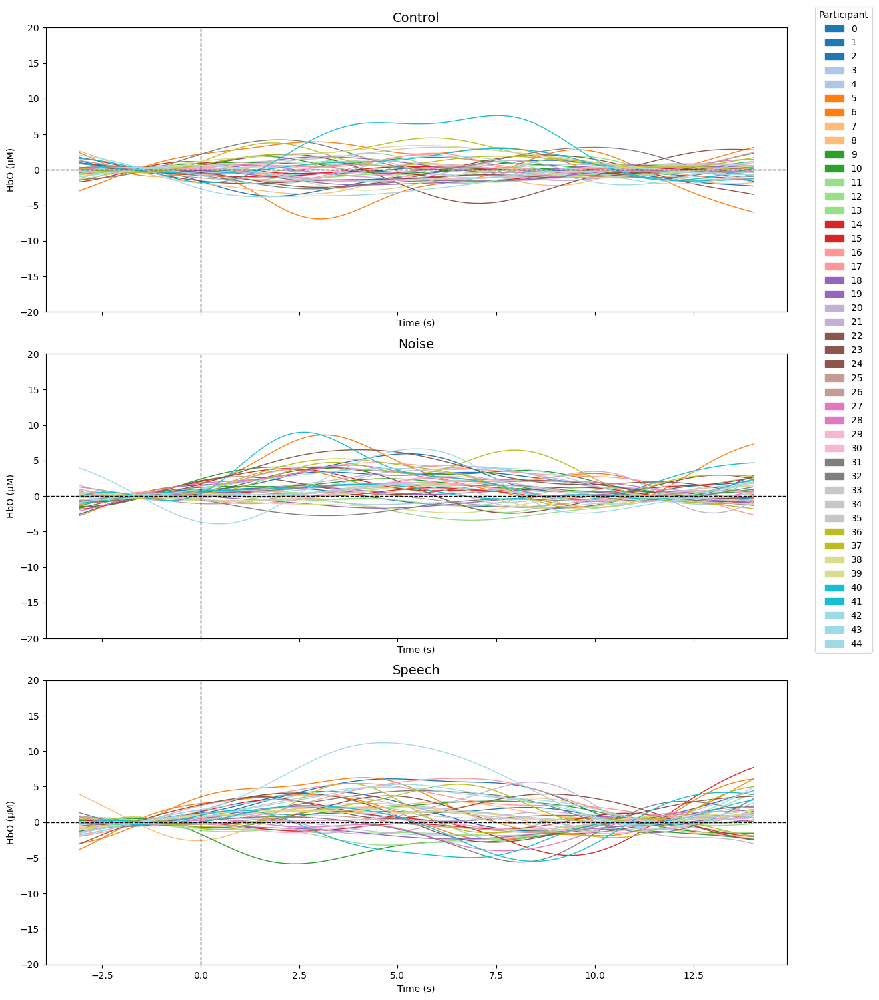

In [112]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch
import matplotlib.cm as cm

for optode in optodes:
    all_evokeds = all_evokeds_dict[optode]
    print(f"Optode: {optode}; Number of sessions: {len(all_evokeds['Control'])}")
    
    if len(all_evokeds['Control']) == 0:
        print(f"No evoked data for {optode}. Skipping...")
        continue
    
    else:

        # Create subplots in 3 rows and 1 column
        fig, axes = plt.subplots(nrows=len(all_evokeds), ncols=1, figsize=(12, 15), sharey=True, sharex=True)


        y_min, y_max = -20, 20

        # Create unique colors for each participant
        num_participants = len(next(iter(all_evokeds.values())))  # assumes all conditions have same participants
        cmap = cm.get_cmap("tab20", num_participants)
        participant_colors = [cmap(i) for i in range(num_participants)]

        # Prepare legend handles
        legend_handles = [Patch(color=participant_colors[i], label=f"{i}") for i in range(num_participants)]

        # Iterate over each condition and plot
        for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
            ax = axes[idx]
            times = evoked_list[0].times

            # Extract only HbO data
            hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # shape: (n_participants, n_channels, n_times)

            # Compute a dictionary of means across participants should be size n_participants x n_times
            mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
            for i in range(len(hbo_data)):
                mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
            
            # Compute mean across participants
            mean_hbo = np.mean(hbo_data, axis=0)  # (n_channels, n_times)
            
            

            # Plot individual participants with unique color
            for i, participant_hbo in enumerate(hbo_data):
                ax.plot(times, mean_channels_all_part[i,:]* 1e6, color=participant_colors[i], alpha=1, linewidth=1)

            # Plot the mean in black
            #ax.plot(times, mean_hbo*1e6, color="black", linewidth=2, label="Mean HbO")

            # Axes formatting
            ax.axhline(0, color='black', linewidth=1, linestyle='--')
            ax.axvline(0, color='black', linewidth=1, linestyle='--')
            ax.set_title(condition, fontsize=14)
            ax.set_xlabel("Time (s)")
            ax.set_ylabel("HbO (μM)")

        # Add one shared legend for all participants
        fig.legend(handles=legend_handles, loc="upper right", title="Participant", bbox_to_anchor=(1.1, 1))

        plt.ylim(y_min, y_max)
        plt.tight_layout()
        plt.show()


# WAA

In [113]:
""" all_ev= all_evokeds_dict['S4D2']
all_ev.items()
for idx, (condition, evoked_list) in enumerate(all_ev.items()):
            ax = axes[idx]
            times = evoked_list[0].times

            # Extract only HbO data
            hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])
hbo_data """

' all_ev= all_evokeds_dict[\'S4D2\']\nall_ev.items()\nfor idx, (condition, evoked_list) in enumerate(all_ev.items()):\n            ax = axes[idx]\n            times = evoked_list[0].times\n\n            # Extract only HbO data\n            hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])\nhbo_data '

In [134]:
import pandas as pd
import numpy as np

# Initialize DataFrame
df = pd.DataFrame(columns=["ID", "ROI", "Chroma", "Condition", "Value"])

# Iterate through each optode
for optode in optodes:
    optode_clean = optode.replace("_", "")
    
    if optode_clean not in all_evokeds_dict:
        print(f"Warning: {optode_clean} not found in all_evokeds_dict")
        continue
    
    all_ev = all_evokeds_dict[optode_clean]

    # Loop through each condition and its evoked list
    for condition, evoked_list in all_ev.items():
        for subj_id, evoked in enumerate(evoked_list, start=1):
            chroma = "hbo"
            try:
                # Pick chroma (hbo) and extract mean value from the time window
                data = evoked.copy().pick(chroma)
                value = data.crop(tmin=3.5, tmax=5.5).data.max() * 1.0e6
                
                value_mean = data.crop(tmin=3.5, tmax=5.5).data.mean() * 1.0e6
                print(f" ID: {subj_id}; Coindition: {condition}; Optode:{optode};  Max Value: {value}; Mean Value: {value_mean}")
                # Append to DataFrame
                this_df = pd.DataFrame(
                    {
                        "ID": subj_id,
                        "ROI": optode,
                        "Chroma": chroma,
                        "Condition": condition,
                        "Value": value,
                    },
                    index=[0],
                )
                df = pd.concat([df, this_df], ignore_index=True)
            except Exception as e:
                print(f"Error processing {optode} - Subject {subj_id} - Condition {condition}: {e}")

# Finalize DataFrame
df.reset_index(inplace=True, drop=True)
df["Value"] = pd.to_numeric(df["Value"], errors='coerce')  # Ensure numerical format

print(df.head())


 ID: 1; Coindition: Control; Optode:S4_D2;  Max Value: -0.4272484543725941; Mean Value: -0.5247005775679838
 ID: 2; Coindition: Control; Optode:S4_D2;  Max Value: -2.683030818401147; Mean Value: -2.9327857239467896
 ID: 3; Coindition: Control; Optode:S4_D2;  Max Value: -0.3787626426138727; Mean Value: -0.9681198906989812
 ID: 4; Coindition: Control; Optode:S4_D2;  Max Value: -1.3791440663587062; Mean Value: -2.061957695324864
 ID: 5; Coindition: Control; Optode:S4_D2;  Max Value: -2.576239323268188; Mean Value: -3.0271712468238725
 ID: 6; Coindition: Control; Optode:S4_D2;  Max Value: -1.3114315531308918; Mean Value: -2.8710389873737174
 ID: 7; Coindition: Control; Optode:S4_D2;  Max Value: 1.447797538151811; Mean Value: 0.4985466008220701
 ID: 8; Coindition: Control; Optode:S4_D2;  Max Value: -2.8403015211087688; Mean Value: -3.217755083472504
 ID: 9; Coindition: Control; Optode:S4_D2;  Max Value: -1.0733334948268645; Mean Value: -1.3848724528276084
 ID: 10; Coindition: Control; Optod

C:\Users\sarab\AppData\Local\Temp\ipykernel_5536\989286052.py:39: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, this_df], ignore_index=True)


 ID: 12; Coindition: Control; Optode:S6_D6;  Max Value: 0.7187493348791206; Mean Value: 0.6260543469905123
 ID: 13; Coindition: Control; Optode:S6_D6;  Max Value: -0.4499457935641735; Mean Value: -0.5448310024601983
 ID: 14; Coindition: Control; Optode:S6_D6;  Max Value: 1.2679446058630761; Mean Value: 1.015572655056874
 ID: 15; Coindition: Control; Optode:S6_D6;  Max Value: -1.345005971930674; Mean Value: -1.7629693189002265
 ID: 16; Coindition: Control; Optode:S6_D6;  Max Value: -1.2218738057715506; Mean Value: -1.6138722998325141
 ID: 17; Coindition: Control; Optode:S6_D6;  Max Value: -3.7081284135392187; Mean Value: -4.226577140597902
 ID: 18; Coindition: Control; Optode:S6_D6;  Max Value: 1.7730977623846516; Mean Value: 1.6275058748613227
 ID: 19; Coindition: Control; Optode:S6_D6;  Max Value: 0.32376007077231134; Mean Value: -0.23520870835046545
 ID: 20; Coindition: Control; Optode:S6_D6;  Max Value: -0.7787217132287956; Mean Value: -1.3455225047112465
 ID: 21; Coindition: Contro

In [ ]:
from scipy.stats import ttest_rel

# Ensure ROI naming consistency
df["ROI"] = df["ROI"].str.replace("_", "", regex=False)

# Step 1: Subject-level means per ROI and condition
grouped = df.groupby(["ID", "ROI", "Condition"])["Value"].mean().reset_index()



# Step 2: Pivot so each condition becomes a column
pivot_df = grouped.pivot(index=["ID", "ROI"], columns="Condition", values="Value").reset_index()

# Step 3: Paired t-tests
results = []

for roi in pivot_df["ROI"].unique():
    roi_data = pivot_df[pivot_df["ROI"] == roi]
    
    if {"Control", "Noise", "Speech"}.issubset(roi_data.columns):
        valid_rows = roi_data.dropna(subset=["Control", "Noise", "Speech"])
        
        # Paired t-tests
        alt = 'two-sided' # 'less' 'greater' 'two-sided'
        
        t_stat_noise, p_val_noise = ttest_rel(valid_rows["Control"], valid_rows["Noise"], alternative= alt)
        t_stat_speech, p_val_speech = ttest_rel(valid_rows["Control"], valid_rows["Speech"], alternative=alt)
        t_stat_noise_speech, p_val_noise_speech = ttest_rel(valid_rows["Noise"], valid_rows["Speech"], alternative=alt)
        
        # Significance check
        sig_noise = "Significant" if p_val_noise < 0.05 else "Not Significant"
        sig_speech = "Significant" if p_val_speech < 0.05 else "Not Significant"
        sig_noise_speech = "Significant" if p_val_noise_speech < 0.05 else "Not Significant"
        
        results.append({
            "ROI": roi,
            "n_subjects": len(valid_rows),
            "Control_vs_Noise_t": t_stat_noise,
            "Control_vs_Noise_p": p_val_noise,
            "Control_vs_Noise_significance": sig_noise,
            "Control_vs_Speech_t": t_stat_speech,
            "Control_vs_Speech_p": p_val_speech,
            "Control_vs_Speech_significance": sig_speech,
            
        })

# Create results DataFrame
results_df = pd.DataFrame(results)

# Display the results
#print(results_df)
# Print significant channels for Control vs Noise
print("\nSignificant Channels for Control vs Noise (p < 0.05):")
signif_noise = results_df[results_df["Control_vs_Noise_significance"] == "Significant"]
print(signif_noise[["ROI", "Control_vs_Noise_p"]])

# Print significant channels for Control vs Speech
print("\nSignificant Channels for Control vs Speech (p < 0.05):")
signif_speech = results_df[results_df["Control_vs_Speech_significance"] == "Significant"]
print(signif_speech[["ROI", "Control_vs_Speech_p"]])




Significant Channels for Control vs Noise (p < 0.05):
       ROI  Control_vs_Noise_p
0   S10D10        5.060974e-05
1   S10D11        1.640107e-07
2   S10D12        4.472097e-05
3    S10D9        1.918533e-05
4   S11D11        1.628345e-05
5   S11D12        3.516383e-08
6    S12D1        2.246426e-05
7     S1D1        6.322208e-05
8     S2D1        6.378600e-04
9     S3D1        1.379574e-03
10    S3D2        3.549004e-05
11    S4D2        8.021794e-07
12    S4D3        1.783380e-04
13    S5D2        1.661983e-07
14    S5D3        1.252617e-04
15    S5D4        5.088740e-04
16    S5D5        1.445343e-03
18    S6D8        9.775580e-04
20    S7D7        1.179586e-02
22    S8D7        4.888461e-03
23    S8D8        7.629333e-03

Significant Channels for Control vs Speech (p < 0.05):
       ROI  Control_vs_Speech_p
0   S10D10         1.064766e-04
1   S10D11         5.080751e-07
2   S10D12         8.411024e-04
3    S10D9         4.986407e-05
4   S11D11         1.558641e-03
5   S11D12     

c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  self._figure.tight_layout(*args, **kwargs)


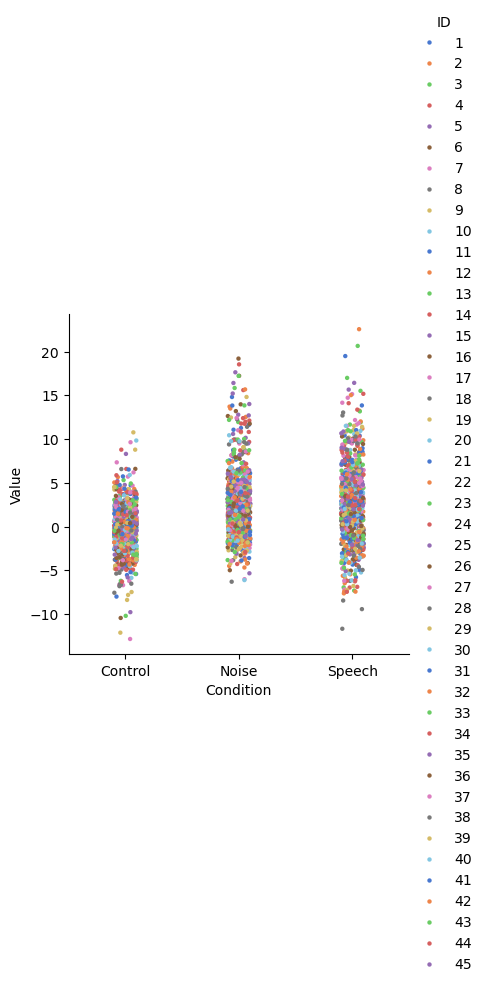

In [127]:
sns.catplot(
    x="Condition",
    y="Value",
    hue="ID",
    data=df.query("Chroma == 'hbo'"),
    errorbar=None,
    palette="muted",
    height=4,
    s=10,
)

# GLM analysis

In [116]:
df_cha

variable,Condition,df,mse,p_value,se,t,theta,Source,Detector,Chroma,Significant,ch_name,id,subject,session,optode
0,Control,9.0,1.736494e-10,1.461590e-06,1.413516e-06,-11.126727,-15.727811,4,2,hbo,True,S4_D2 hbo,1,01,1,S4D2
1,Noise,9.0,1.736494e-10,9.208089e-01,1.403623e-06,0.102239,0.143505,4,2,hbo,False,S4_D2 hbo,1,01,1,S4D2
2,Speech,9.0,1.736494e-10,4.349539e-03,1.411465e-06,-3.779922,-5.335228,4,2,hbo,True,S4_D2 hbo,1,01,1,S4D2
3,constant,9.0,1.736494e-10,2.734878e-04,2.933915e-07,5.758115,1.689382,4,2,hbo,True,S4_D2 hbo,1,01,1,S4D2
4,drift_1,9.0,1.736494e-10,2.712973e-03,2.645955e-05,-4.091000,-108.246017,4,2,hbo,True,S4_D2 hbo,1,01,1,S4D2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15895,drift_1,9.0,2.203862e-11,4.681791e-07,9.400177e-06,12.719531,119.565844,12,1,hbr,True,S12_D1 hbr,45,24,2,S12D1
15896,drift_2,9.0,2.203862e-11,7.887667e-07,9.447347e-06,-11.966100,-113.047895,12,1,hbr,True,S12_D1 hbr,45,24,2,S12D1
15897,drift_3,9.0,2.203862e-11,3.899565e-07,9.398557e-06,12.993549,122.120609,12,1,hbr,True,S12_D1 hbr,45,24,2,S12D1
15898,drift_4,9.0,2.203862e-11,1.041416e-06,9.464837e-06,-11.581274,-109.614879,12,1,hbr,True,S12_D1 hbr,45,24,2,S12D1


In [117]:
df_cha_channels= df_cha.copy()
df_cha_channels["ch_name_ind"] = df_cha["ch_name"].str.extract(r"^(\S+)")

df_cha_Control= df_cha_channels[df_cha_channels["Condition"] == "Control"]
df_cha_Control_hbo= df_cha_Control[df_cha_Control["Chroma"] == "hbo"]
# noise
df_cha_noise = df_cha_channels[df_cha_channels["Condition"] == "Noise"]
df_cha_noise_hbo= df_cha_noise[df_cha_noise["Chroma"] == "hbo"]

# speech
df_cha_speech = df_cha_channels[df_cha_channels["Condition"] == "Speech"]
df_cha_speech_hbo= df_cha_speech[df_cha_speech["Chroma"] == "hbo"]


In [118]:
# import ttest_rel
from scipy.stats import ttest_rel
optodes = ["S4_D2", "S6_D6", "S4_D3", "S5_D2", "S5_D3", "S5_D4", "S5_D5", 
           "S10_D9", "S10_D10", "S10_D11", "S10_D12", "S11_D11", "S11_D12", 
           "S6_D8", "S7_D6", "S7_D7", "S7_D8", "S8_D7", "S8_D8", "S9_D8", 
           "S1_D1", "S2_D1", "S3_D1", "S3_D2", "S12_D1"]

# Store results
results = []
# Perform paired t-tests per optode
for opt in optodes:
    df_c = df_cha_Control_hbo[df_cha_Control_hbo["ch_name_ind"] == opt]
    #print(df_c)
    df_n = df_cha_noise_hbo[df_cha_noise_hbo["ch_name_ind"] == opt]
    df_s = df_cha_speech_hbo[df_cha_speech_hbo["ch_name_ind"] == opt]

    for cond1, cond2, name1, name2 in [(df_c, df_n, "Control", "Noise"), 
                                       (df_c, df_s, "Control", "Speech"), 
                                       (df_n, df_s, "Noise", "Speech")]:
        merged = pd.merge(cond1[["id", "theta"]], cond2[["id", "theta"]], on="id", suffixes=("_1", "_2"))
        if len(merged) > 1:
            t_stat, p_val = ttest_rel(merged["theta_1"], merged["theta_2"])
            results.append({
                "Optode": opt,
                "Comparison": f"{name1} vs {name2}",
                "n": len(merged),
                "t_statistic": t_stat,
                "p_value": p_val
            })

# Convert to DataFrame
results_df = pd.DataFrame(results)
# Add a column to indicate significance
results_df["Significant"] = results_df["p_value"] < 0.05

# Display the updated results
print(results_df)


    Optode         Comparison   n  t_statistic   p_value  Significant
0    S4_D2   Control vs Noise  41    -1.194927  0.239153        False
1    S4_D2  Control vs Speech  41    -1.193139  0.239844        False
2    S4_D2    Noise vs Speech  41    -0.142647  0.887285        False
3    S6_D6   Control vs Noise  28    -1.094346  0.283470        False
4    S6_D6  Control vs Speech  28    -0.295530  0.769850        False
..     ...                ...  ..          ...       ...          ...
70   S3_D2  Control vs Speech  44    -0.392700  0.696481        False
71   S3_D2    Noise vs Speech  44    -1.050890  0.299179        False
72  S12_D1   Control vs Noise  45    -0.505726  0.615573        False
73  S12_D1  Control vs Speech  45     0.045827  0.963655        False
74  S12_D1    Noise vs Speech  45     0.440091  0.662025        False

[75 rows x 6 columns]


In [119]:
# do a new dataframe with the results that are significant
significant_results = results_df[results_df["Significant"]]
significant_results['Optode'].unique()

array(['S11_D12', 'S7_D6', 'S7_D7', 'S8_D8', 'S9_D8'], dtype=object)

In [120]:
significant_results_control_noise = significant_results[significant_results["Comparison"] == "Control vs Noise"]
significant_results_control_speech = significant_results[significant_results["Comparison"] == "Control vs Speech"]
significant_results_noise_speech = significant_results[significant_results["Comparison"] == "Noise vs Speech"]

In [121]:
significant_results_control_noise['Optode'].unique()

array(['S7_D6', 'S7_D7'], dtype=object)

In [122]:
significant_results_control_speech['Optode'].unique()

array(['S11_D12', 'S7_D6', 'S8_D8', 'S9_D8'], dtype=object)

In [123]:
significant_results_noise_speech['Optode'].unique()

array([], dtype=object)